In [1]:
import pandas as pd
import polars as pl
import numpy as np
import os

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns

from sklearn.decomposition import PCA, FastICA

import torch
from torch.utils.data import DataLoader, Dataset

from mne.preprocessing import ICA

from scipy import signal
from scipy.ndimage import median_filter


from src.styles import *
set_styles()

In [2]:
def target_status(row):
    num_annot = row.iloc[-6:].sum()
    if (num_annot < 3):
        return 'weak'
    
    row = row.iloc[-6:] / num_annot
    delta = 2. / num_annot
    if (row.iloc[-6:] == 1).any():
        return 'ideal'
    elif (row['other_vote'] >= (0.5 - delta)) & (row['other_vote'] <= (0.5 + delta)) & (row.iloc[-6:-1] == (1. - row['other_vote'])).any():
        return 'proto'
    elif (row['other_vote'] < delta):
        for i in range(2, 7):
            cur = row.iloc[-i]
            if (cur >= (0.5 - delta)) & (cur <= (0.5 + delta)):
                if ((row.iloc[-6:-i] == (1. - cur)).any()) | ((row.iloc[-i+1:-1] == (1. - cur)).any()):
                    return 'edge'
                
    return 'weak'

In [3]:
path = 'data/train.csv'
df = pd.read_csv(path).sort_values(['eeg_id', 'eeg_label_offset_seconds'])
dif = df['eeg_label_offset_seconds'] - df['eeg_label_offset_seconds'].shift(1)
df = df.loc[~((dif > 0) & (dif < 50))].reset_index(drop=True) # use only different events

num_annotators = df.iloc[:, -6:].sum(axis=1)
status = df.apply(lambda row: target_status(row), axis=1)

df.insert(df.shape[1] - 7, 'num_annotators', num_annotators)
df.insert(df.shape[1] - 7, 'status', status)
df

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,num_annotators,status,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,568657,0,0.0,789577333,0,0.0,1825637311,20654,12,weak,Other,0,0,3,0,2,7
1,582999,0,0.0,1552638400,0,0.0,1722186807,20230,14,weak,LPD,0,12,0,1,0,1
2,642382,0,0.0,14960202,12,1008.0,3254468733,5955,1,weak,Other,0,0,0,0,0,1
3,751790,0,0.0,618728447,4,908.0,2898467035,38549,1,weak,GPD,0,0,1,0,0,0
4,778705,0,0.0,52296320,0,0.0,3255875127,40955,2,weak,Other,0,0,0,0,0,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17084,4293354003,0,0.0,1188113564,0,0.0,447244163,16610,2,weak,GRDA,0,0,0,0,1,1
17085,4293843368,0,0.0,1549502620,0,0.0,1618953053,15065,2,weak,GRDA,0,0,0,0,1,1
17086,4294455489,0,0.0,2105480289,0,0.0,469526364,56,1,weak,Other,0,0,0,0,0,1
17087,4294858825,0,0.0,657299228,0,0.0,561576493,4312,15,weak,Other,0,0,0,0,1,14


In [4]:
SR = 200
LEN_SEC = 50
DPI=100

def display_eegs(data, label, offset=0):

    df = data.loc[int(offset*SR): int((offset+LEN_SEC)*SR), :]

    fig, ax = plt.subplots(1,1, figsize=(12, 4))

    # display all channels
    for i, col in enumerate(df.columns):
        sns.lineplot(x=np.linspace(0, df.shape[0] // SR, df.shape[0]), y=df[col] / 10 + i, color='black', ax=ax, alpha=0.5, linewidth=1)
        ax.text(-3, i, col)

    # highlight event
    h = df.shape[1] - 1
    w = LEN_SEC
    rect=mpatches.Rectangle((0.4*w,-1),0.2*w,h + 1*2, facecolor=PALETTE[0], alpha=0.3)
    ax.add_patch(rect)

    ax.set_xticks(np.arange(0, 50, 10), np.arange(0, 50, 10))
    ax.grid(axis='x')
        
    ax.set_xlabel('seconds')
    ax.set_ylabel('')
    ax.set_yticklabels([])

    ax.set_title(label, loc='center')
    
    plt.tight_layout()
    plt.show()

In [5]:
def get_diagnosis(dict):
    res = ''
    for k,v in dict.items():
        if v > 0:
            res += '| ' + k[:-5] + ' ' + str(v) + ' |'
    return res

In [6]:
N_EXAMPLES = 4

df_ideal = df.loc[df['status'] == 'ideal'] \
    .sort_values(['expert_consensus', 'num_annotators'], ascending=False) \
    .groupby('expert_consensus') \
    .head(N_EXAMPLES)
df_ideal

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,num_annotators,status,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
8399,2088807520,0,0.0,198643605,0,0.0,2493314214,40881,16,ideal,Seizure,16,0,0,0,0,0
12152,3030710864,0,0.0,388803499,0,0.0,2569163393,14965,16,ideal,Seizure,16,0,0,0,0,0
932,241433122,0,0.0,2058601455,0,0.0,663904781,4863,15,ideal,Seizure,15,0,0,0,0,0
3191,794842413,0,0.0,1946784308,0,0.0,3303915154,24619,15,ideal,Seizure,15,0,0,0,0,0
2622,658623458,0,0.0,746484395,0,0.0,1066857183,63946,23,ideal,Other,0,0,0,0,0,23
2366,590374806,0,0.0,766843679,0,0.0,2332265795,36490,22,ideal,Other,0,0,0,0,0,22
3266,811958440,0,0.0,1863972381,0,0.0,2545608526,9223,21,ideal,Other,0,0,0,0,0,21
3738,936283997,0,0.0,1119143423,0,0.0,1615809118,1568,21,ideal,Other,0,0,0,0,0,21
10897,2713014975,0,0.0,780890284,0,0.0,3734439265,31386,10,ideal,LRDA,0,0,0,10,0,0
3358,839459106,0,0.0,995785734,2,534.0,1826634126,37979,5,ideal,LRDA,0,0,0,5,0,0


# Display raw EEGs

2088807520


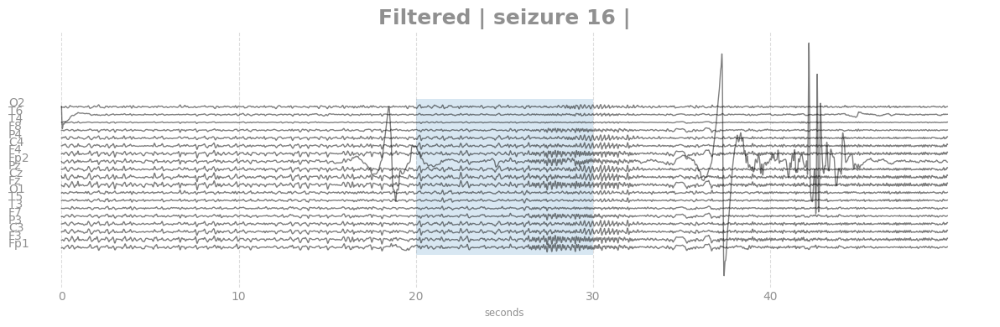

3030710864


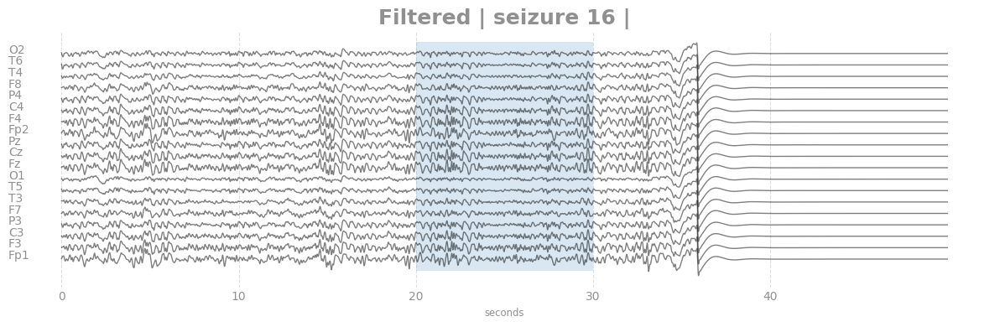

241433122


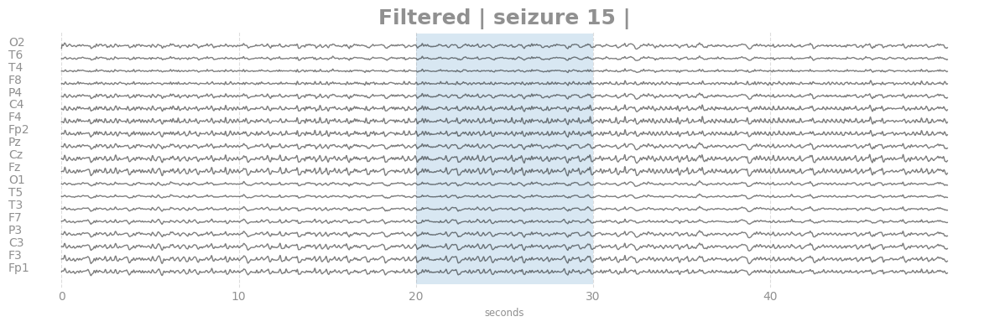

794842413


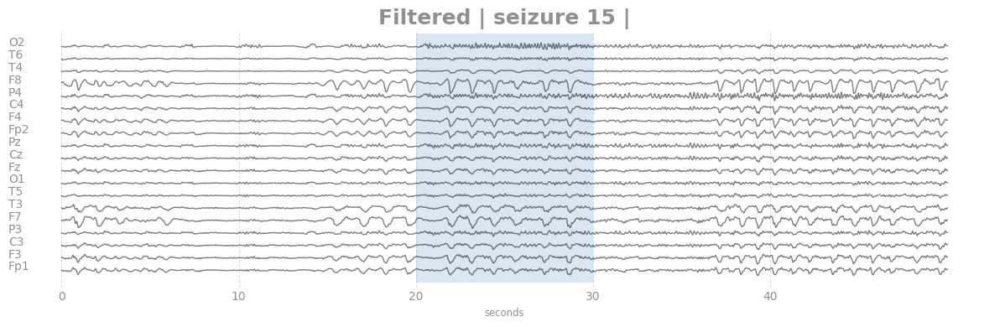

658623458


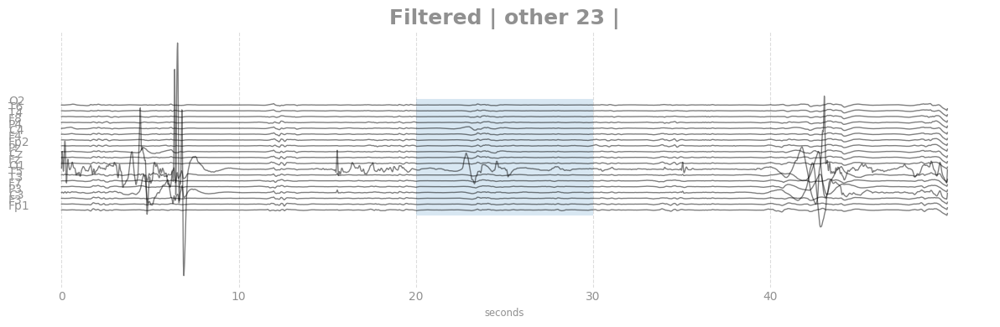

590374806


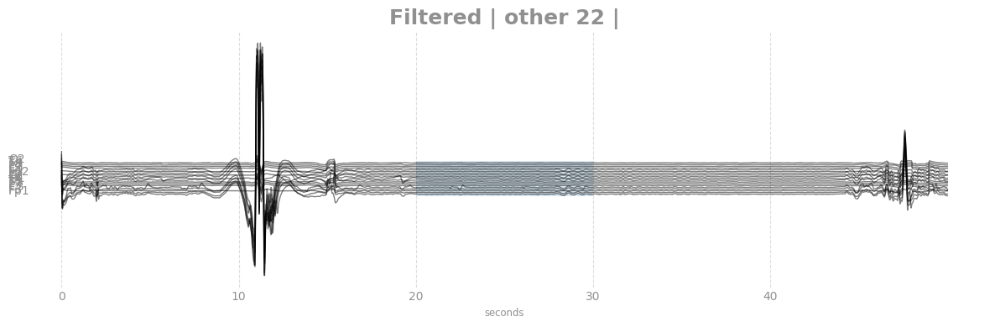

811958440


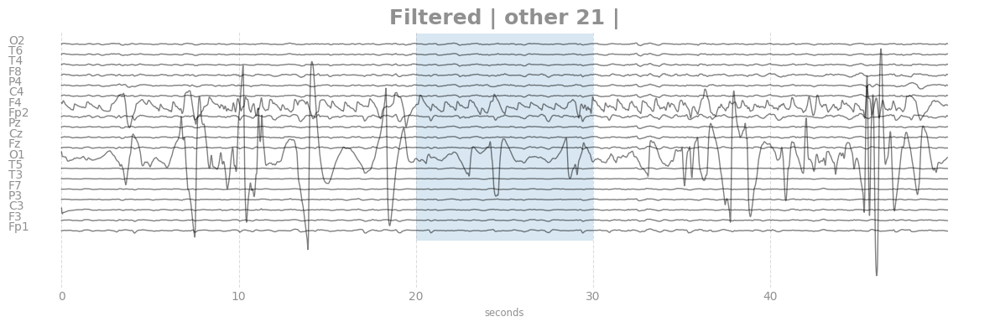

936283997


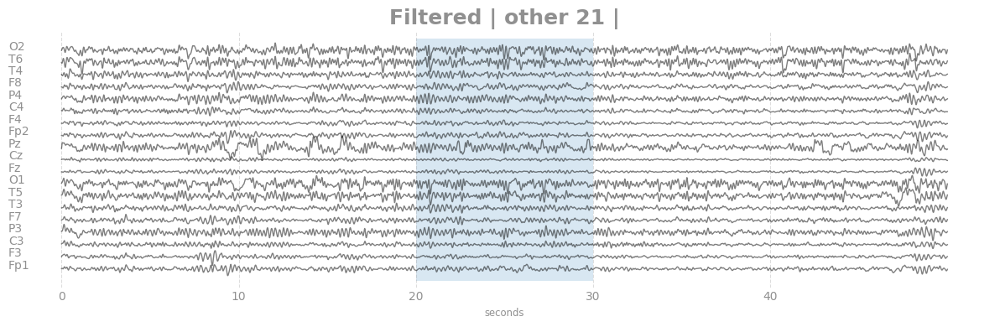

2713014975


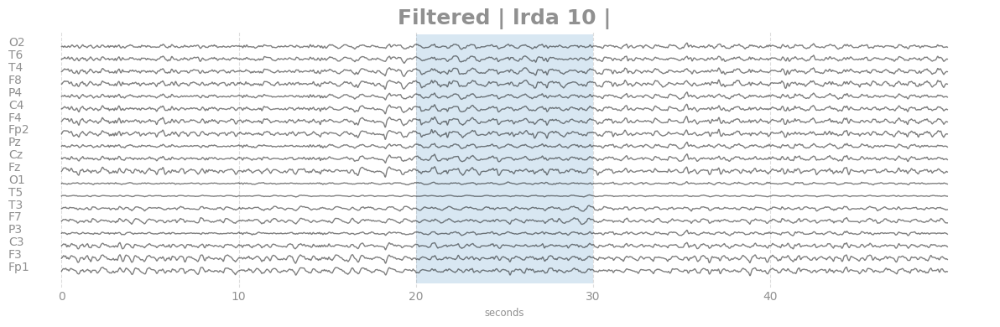

839459106


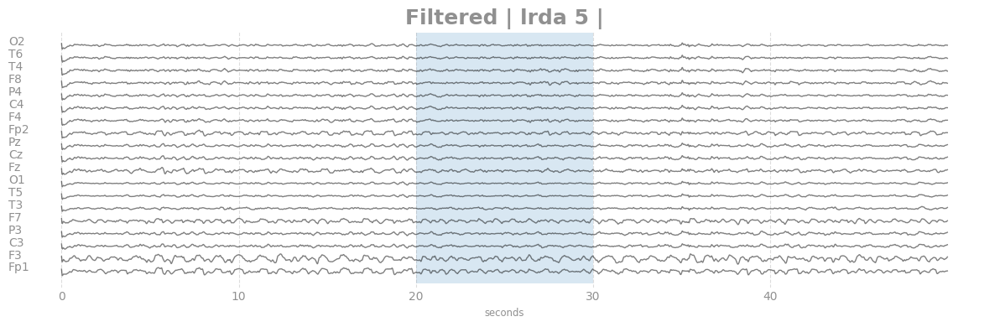

7585449


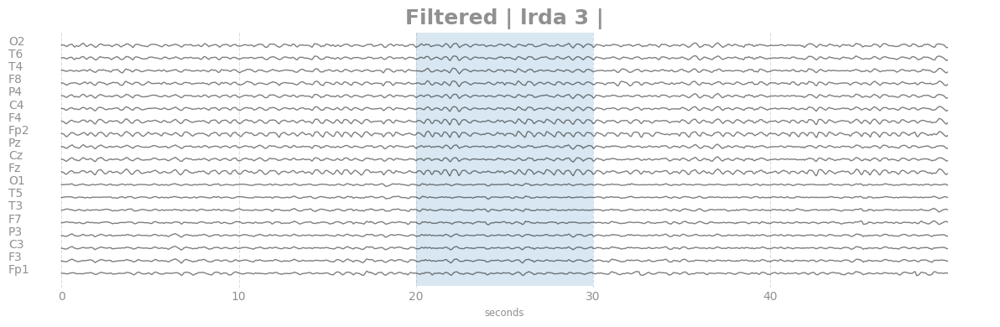

50469106


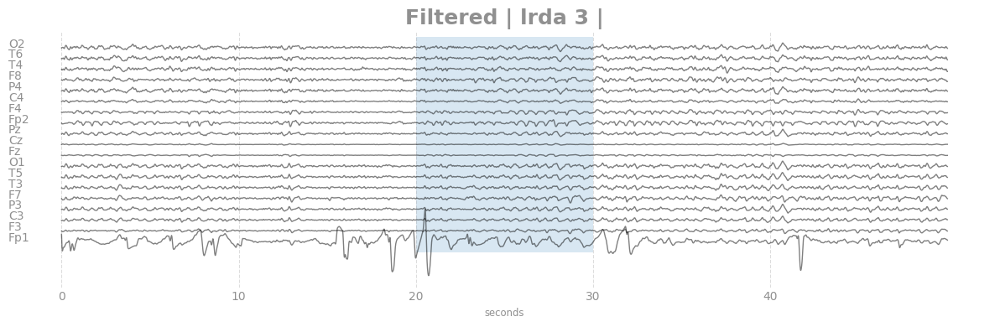

1317431280


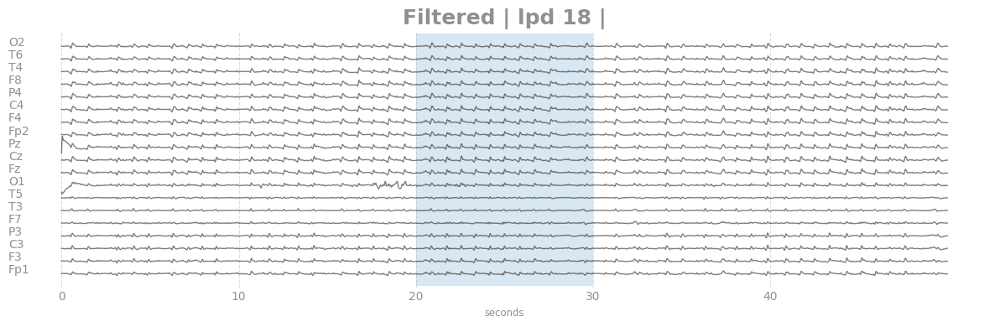

1898956741


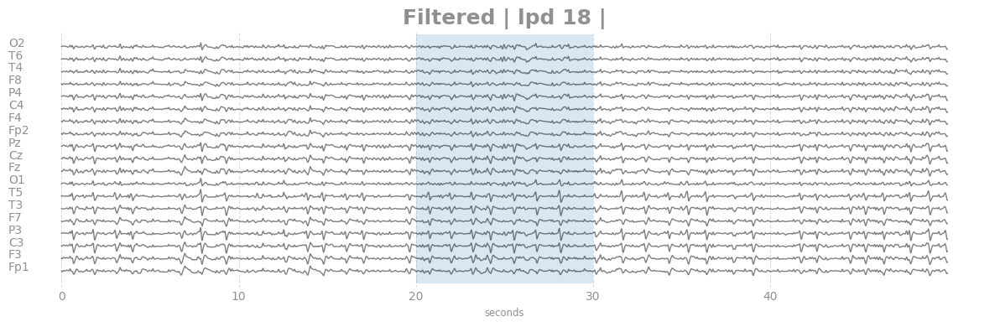

4221431176


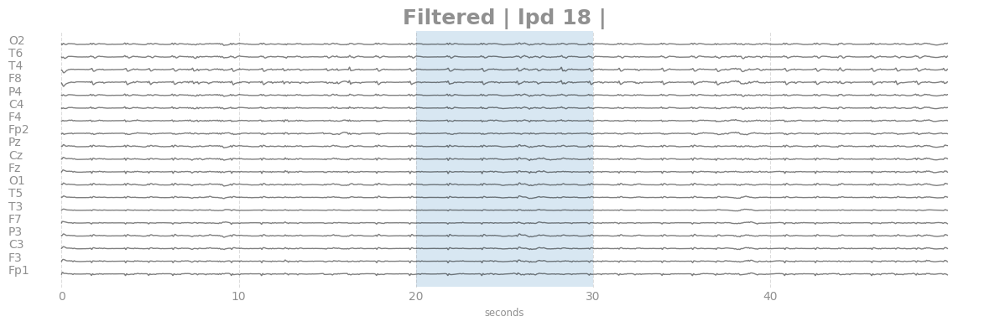

35755743


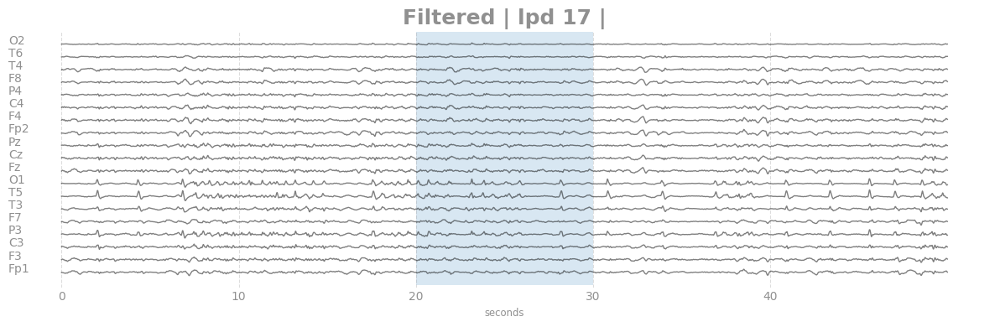

167136080


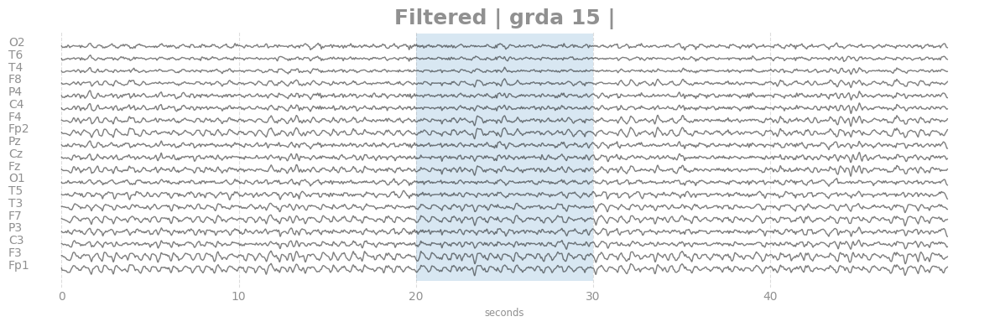

944845698


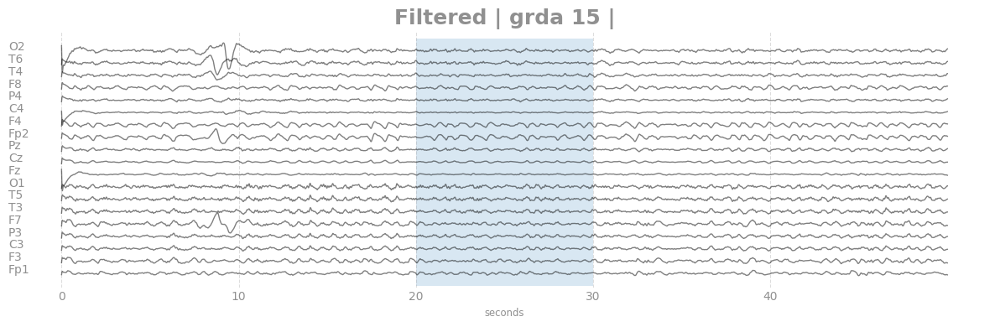

963265939


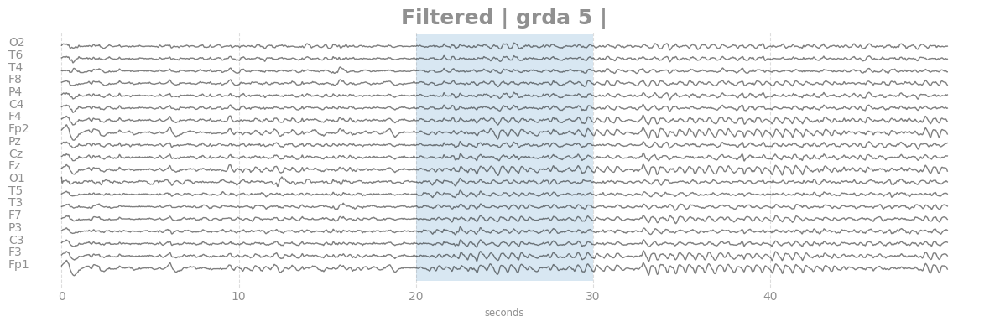

5168624


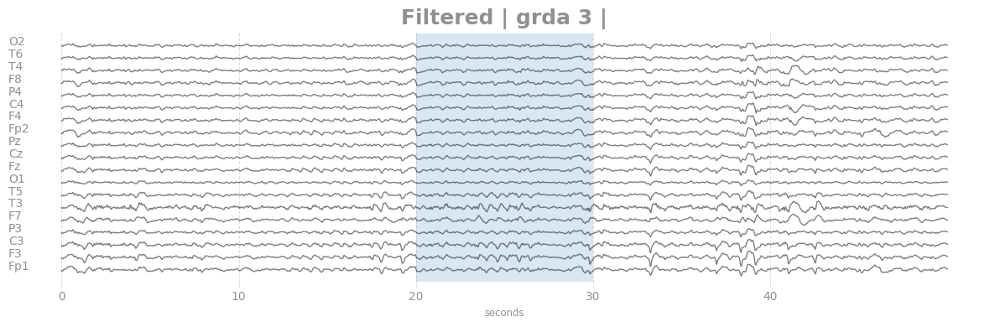

1058173302


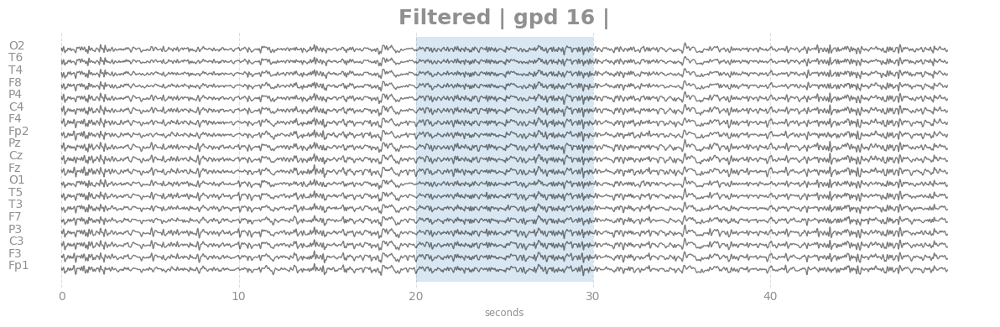

1300795281


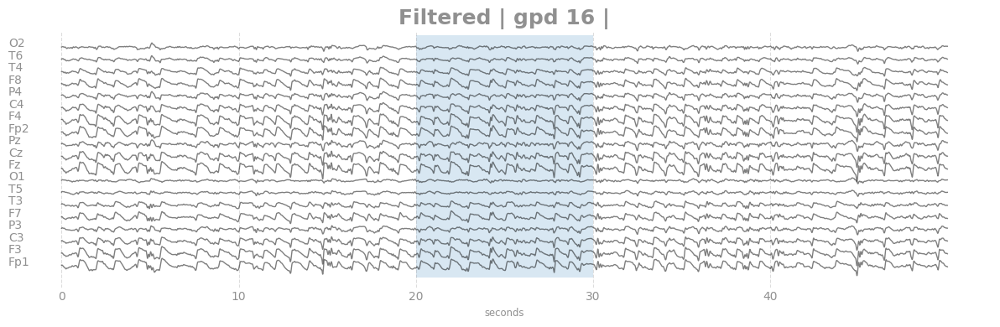

1463717064


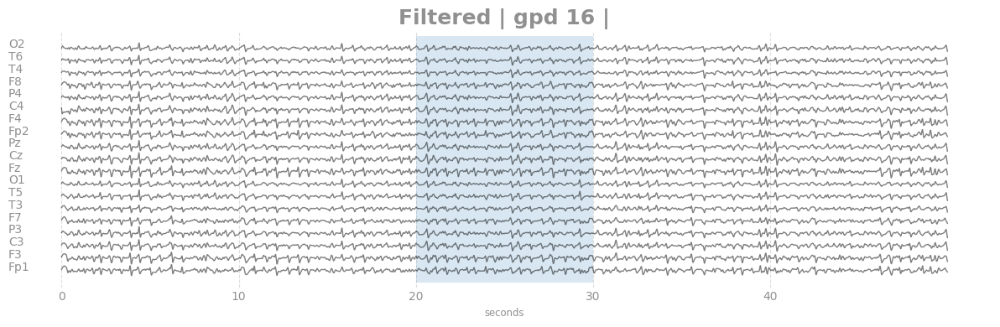

1606805366


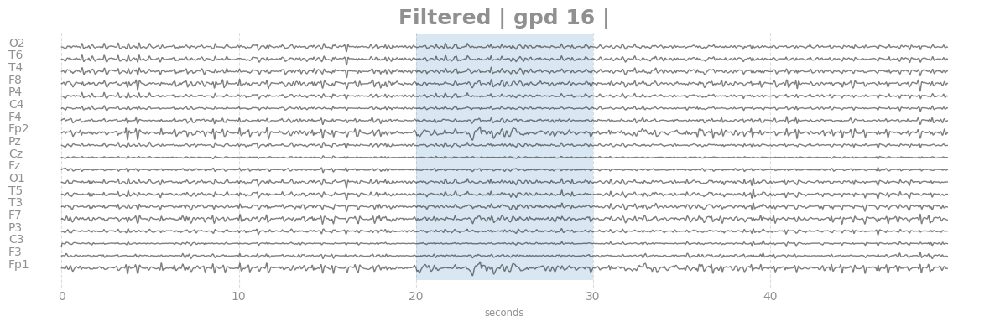

In [7]:
def filter_eeg(eeg):
    b, a = signal.butter(N=4, Wn=[0.5, 10], btype='band', fs=SR)
    filtered_data = signal.filtfilt(b, a, eeg.values, axis=0)
    return pd.DataFrame(filtered_data, columns=eeg.columns)

path_eeg = 'data/train_eegs/'

eps = 1e-10

for index, row in df_ideal.iterrows():
    print(row['eeg_id'])
    
    label = get_diagnosis(row.iloc[-6:].to_dict())
    eeg = pd.read_parquet(path_eeg + f'{row["eeg_id"]}.parquet').drop('EKG', axis=1).fillna(0)

    eeg_filt = filter_eeg(eeg)
    display_eegs(eeg_filt / 32., 'Filtered ' + label)

# Display ICA

Independent Component Analysis on EEG features

2088807520


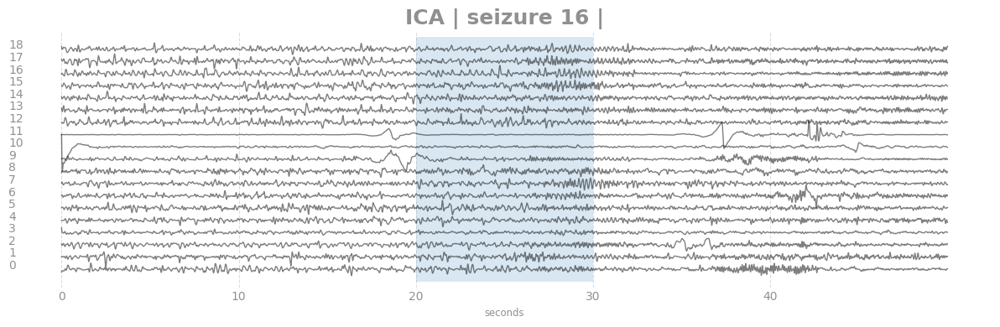

3030710864


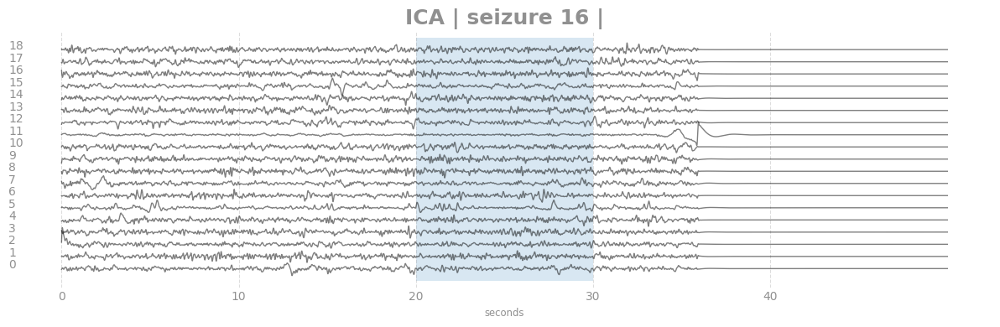

241433122


C:\Users\Hawkins\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\sklearn\decomposition\_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


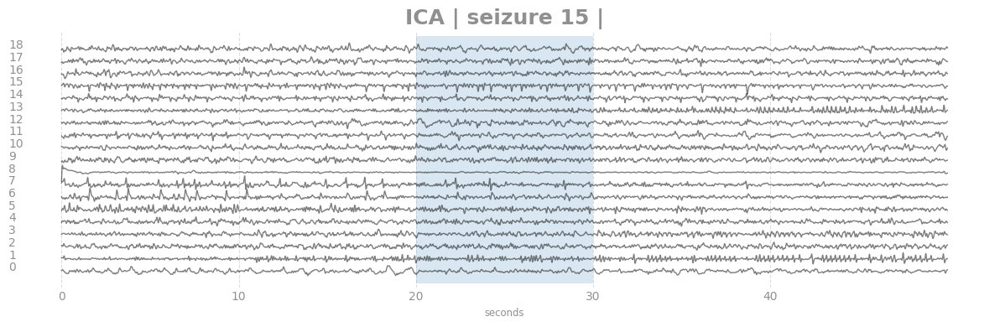

794842413


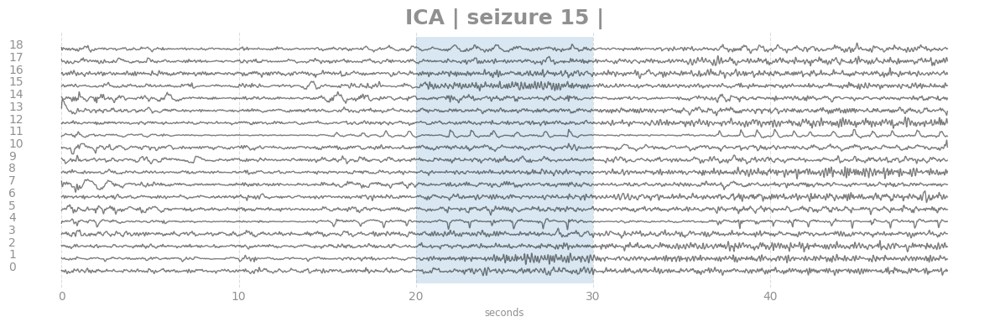

658623458


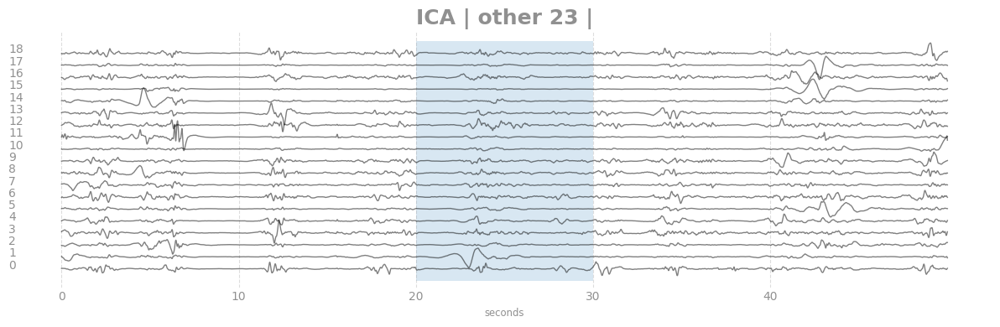

590374806


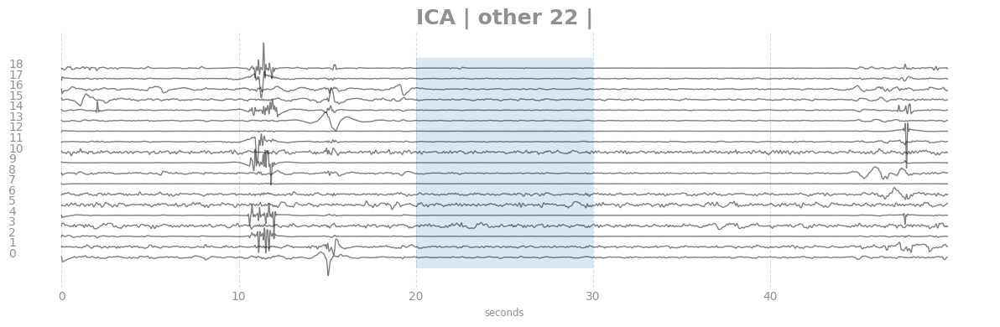

811958440


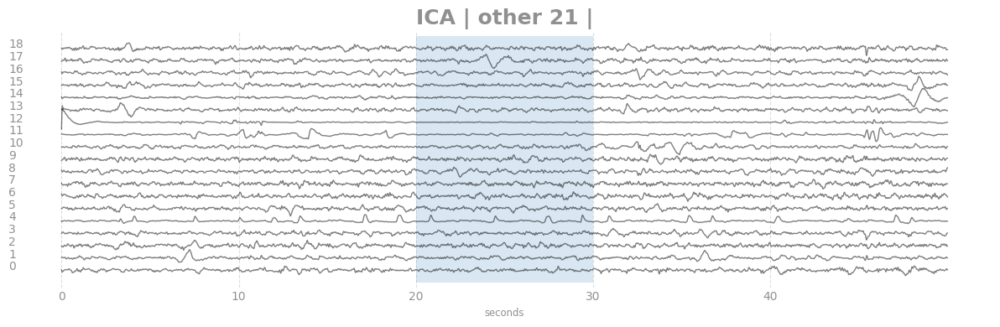

936283997


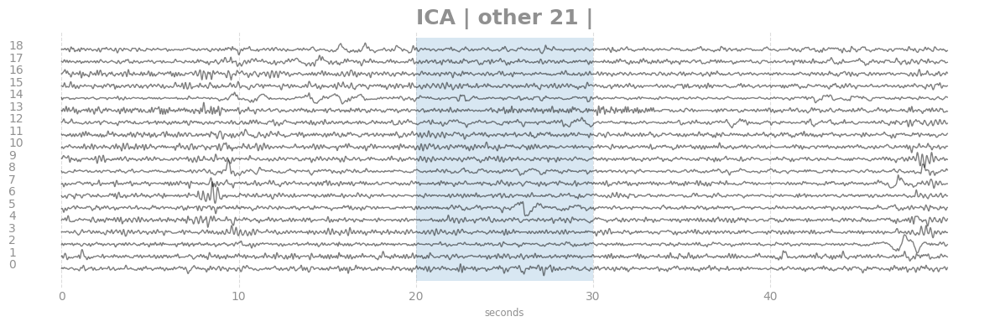

2713014975


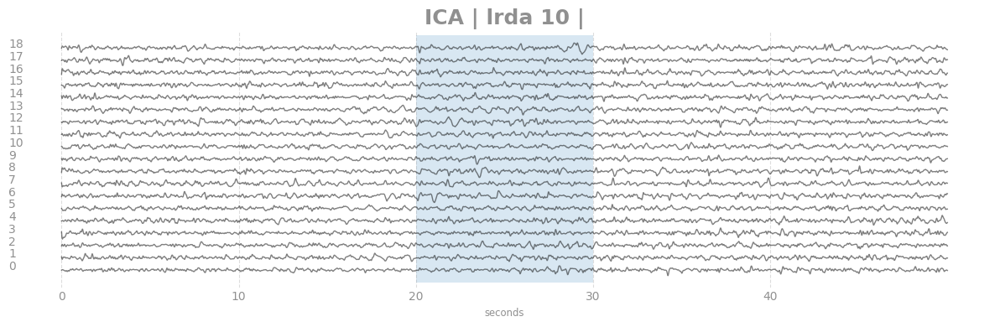

839459106


C:\Users\Hawkins\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\sklearn\decomposition\_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


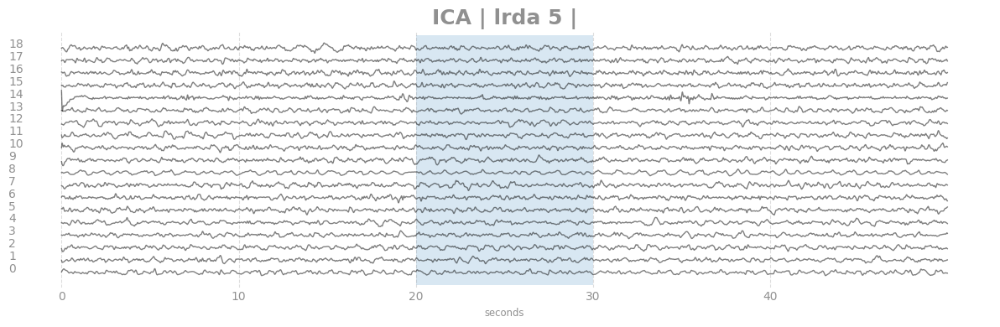

7585449


C:\Users\Hawkins\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\sklearn\decomposition\_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


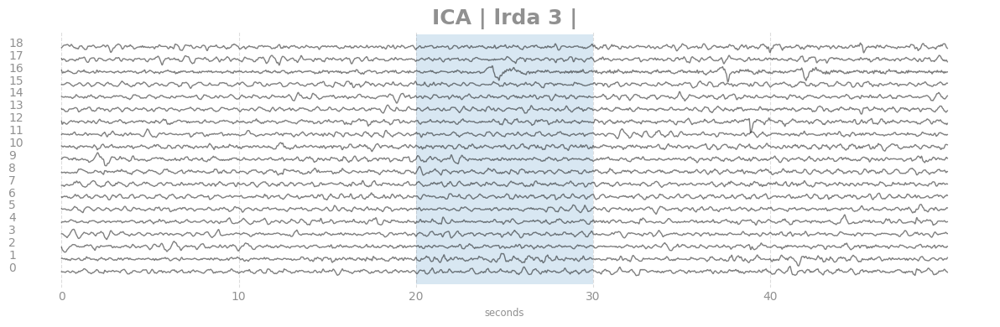

50469106


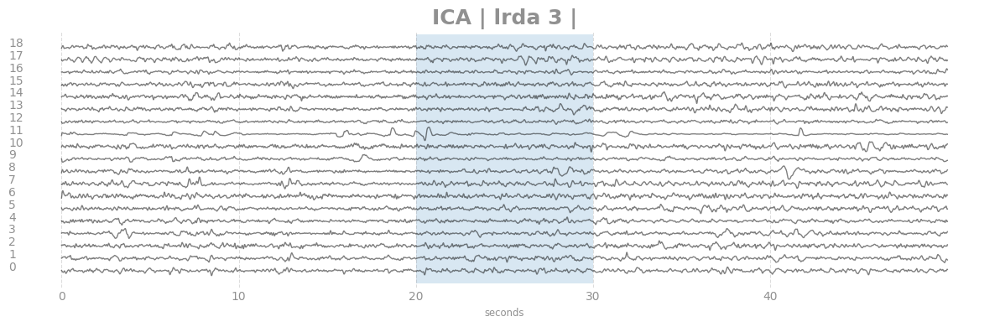

1317431280


C:\Users\Hawkins\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\sklearn\decomposition\_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


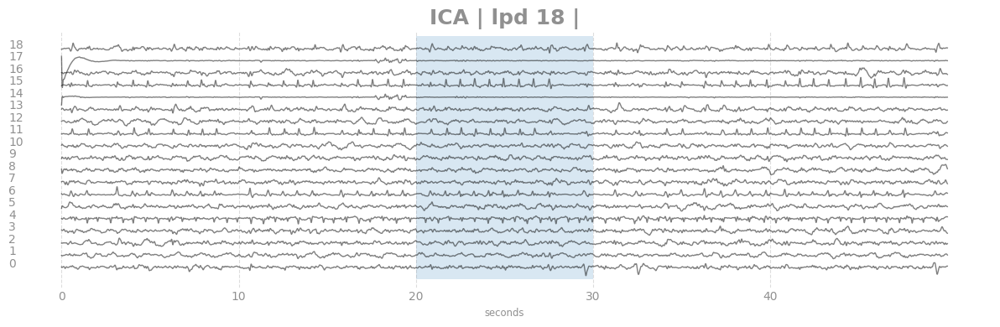

1898956741


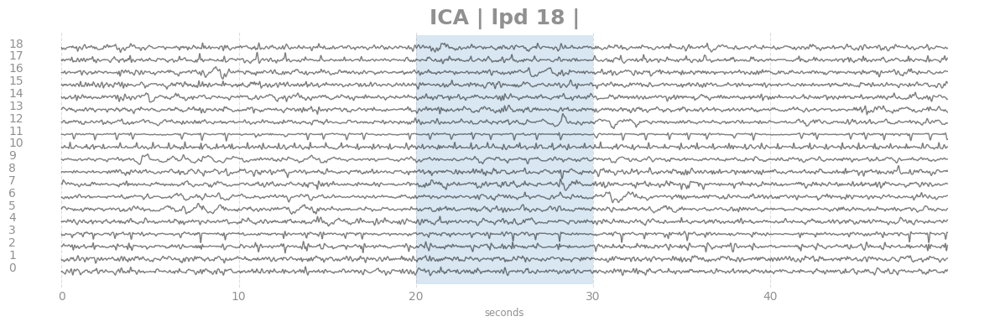

4221431176


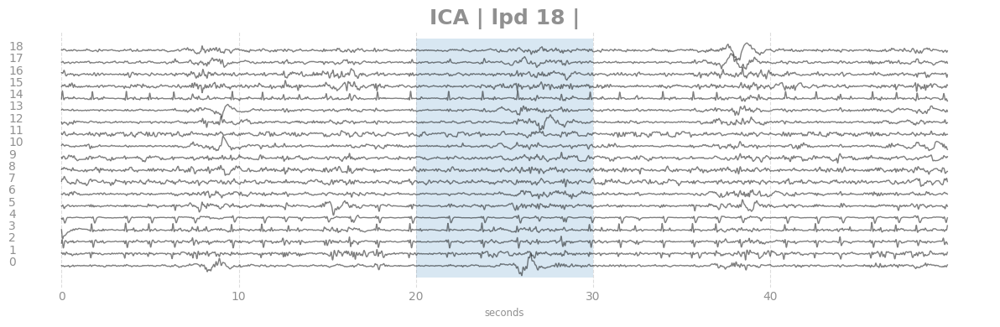

35755743


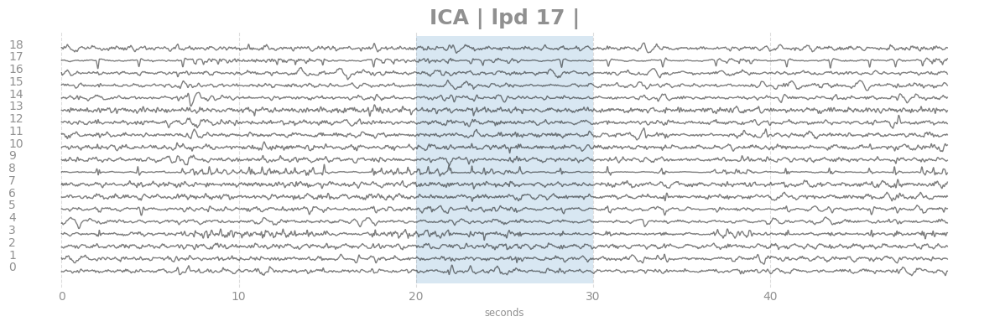

167136080


C:\Users\Hawkins\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\sklearn\decomposition\_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


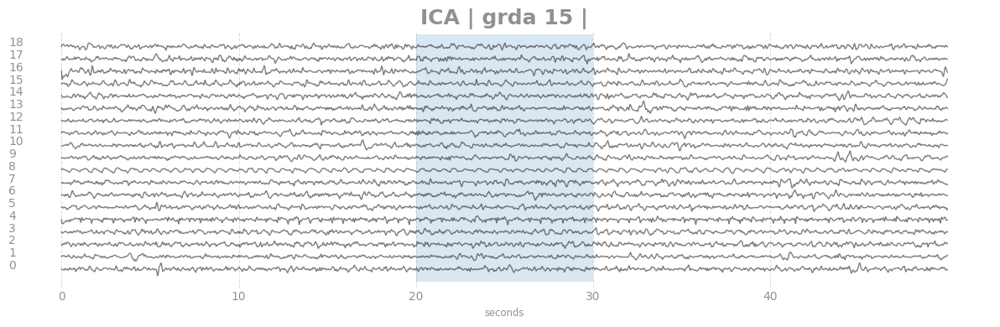

944845698


C:\Users\Hawkins\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\sklearn\decomposition\_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


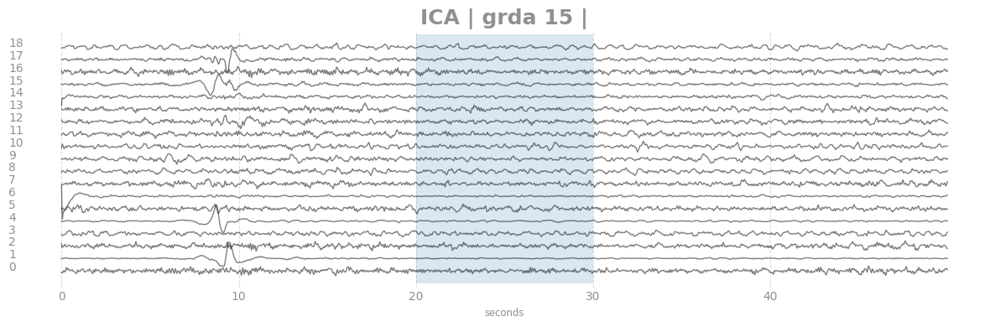

963265939


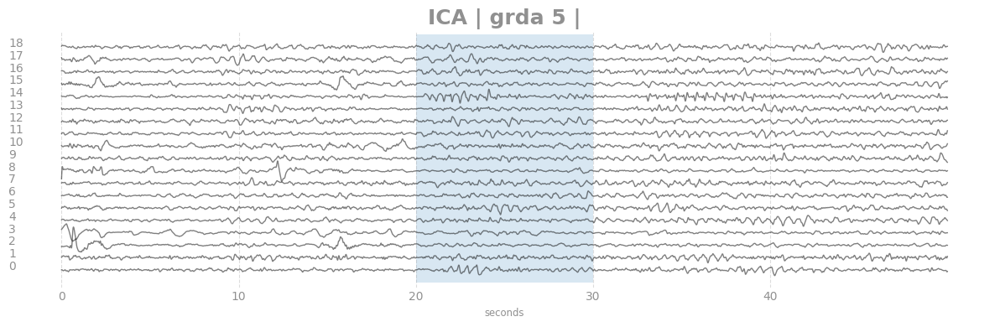

5168624


C:\Users\Hawkins\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\sklearn\decomposition\_fastica.py:128: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


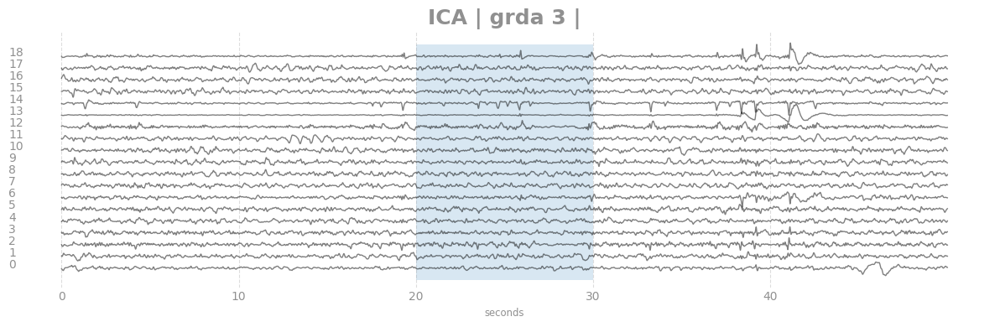

1058173302


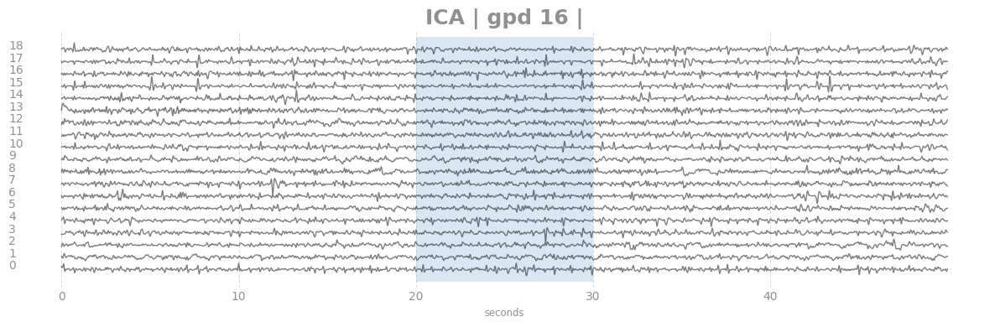

1300795281


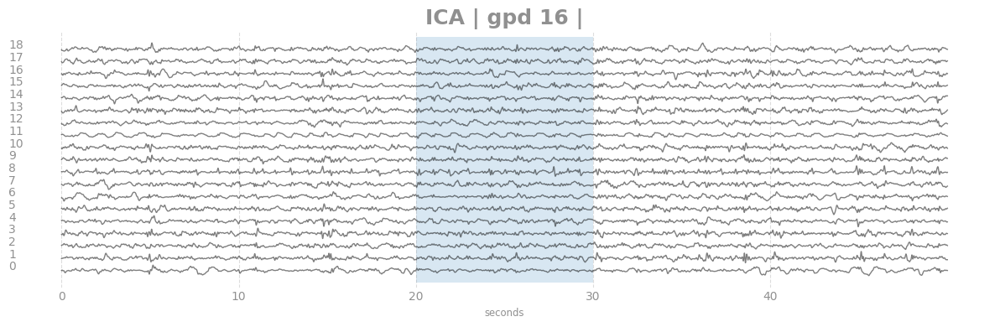

1463717064


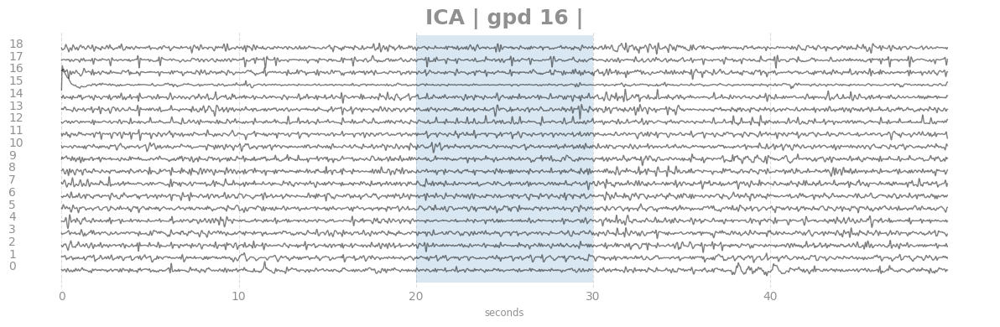

1606805366


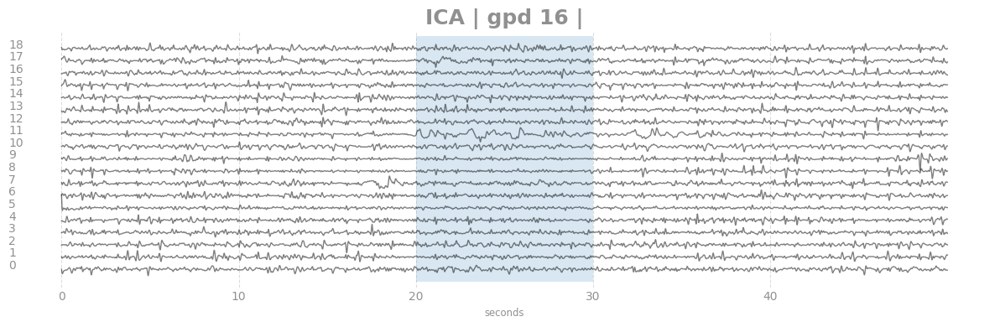

In [8]:
def filter_eeg(eeg):
    b, a = signal.butter(N=4, Wn=[0.5, 10], btype='band', fs=SR)
    filtered_data = signal.filtfilt(b, a, eeg.values, axis=0)
    return pd.DataFrame(filtered_data, columns=eeg.columns)

path_eeg = 'data/train_eegs/'
path_spectrogram = 'data/train_spectrograms/'
SPECTROGRAMS = ['LL','LP','RP','RL']
SP_LEN = 300
SP_NUM_FREQ = 100
SPECTROGRAM_COLS = [
['LL_0.59', 'LL_0.78', 'LL_0.98', 'LL_1.17', 'LL_1.37', 'LL_1.56', 'LL_1.76', 'LL_1.95', 'LL_2.15', 'LL_2.34', 'LL_2.54', 'LL_2.73', 'LL_2.93', 'LL_3.13', 'LL_3.32', 'LL_3.52', 'LL_3.71', 'LL_3.91', 'LL_4.1', 'LL_4.3', 'LL_4.49', 'LL_4.69', 'LL_4.88', 'LL_5.08', 'LL_5.27', 'LL_5.47', 'LL_5.66', 'LL_5.86', 'LL_6.05', 'LL_6.25', 'LL_6.45', 'LL_6.64', 'LL_6.84', 'LL_7.03', 'LL_7.23', 'LL_7.42', 'LL_7.62', 'LL_7.81', 'LL_8.01', 'LL_8.2', 'LL_8.4', 'LL_8.59', 'LL_8.79', 'LL_8.98', 'LL_9.18', 'LL_9.38', 'LL_9.57', 'LL_9.77', 'LL_9.96', 'LL_10.16', 'LL_10.35', 'LL_10.55', 'LL_10.74', 'LL_10.94', 'LL_11.13', 'LL_11.33', 'LL_11.52', 'LL_11.72', 'LL_11.91', 'LL_12.11', 'LL_12.3', 'LL_12.5', 'LL_12.7', 'LL_12.89', 'LL_13.09', 'LL_13.28', 'LL_13.48', 'LL_13.67', 'LL_13.87', 'LL_14.06', 'LL_14.26', 'LL_14.45', 'LL_14.65', 'LL_14.84', 'LL_15.04', 'LL_15.23', 'LL_15.43', 'LL_15.63', 'LL_15.82', 'LL_16.02', 'LL_16.21', 'LL_16.41', 'LL_16.6', 'LL_16.8', 'LL_16.99', 'LL_17.19', 'LL_17.38', 'LL_17.58', 'LL_17.77', 'LL_17.97', 'LL_18.16', 'LL_18.36', 'LL_18.55', 'LL_18.75', 'LL_18.95', 'LL_19.14', 'LL_19.34', 'LL_19.53', 'LL_19.73', 'LL_19.92'],
['LP_0.59', 'LP_0.78', 'LP_0.98', 'LP_1.17', 'LP_1.37', 'LP_1.56', 'LP_1.76', 'LP_1.95', 'LP_2.15', 'LP_2.34', 'LP_2.54', 'LP_2.73', 'LP_2.93', 'LP_3.13', 'LP_3.32', 'LP_3.52', 'LP_3.71', 'LP_3.91', 'LP_4.1', 'LP_4.3', 'LP_4.49', 'LP_4.69', 'LP_4.88', 'LP_5.08', 'LP_5.27', 'LP_5.47', 'LP_5.66', 'LP_5.86', 'LP_6.05', 'LP_6.25', 'LP_6.45', 'LP_6.64', 'LP_6.84', 'LP_7.03', 'LP_7.23', 'LP_7.42', 'LP_7.62', 'LP_7.81', 'LP_8.01', 'LP_8.2', 'LP_8.4', 'LP_8.59', 'LP_8.79', 'LP_8.98', 'LP_9.18', 'LP_9.38', 'LP_9.57', 'LP_9.77', 'LP_9.96', 'LP_10.16', 'LP_10.35', 'LP_10.55', 'LP_10.74', 'LP_10.94', 'LP_11.13', 'LP_11.33', 'LP_11.52', 'LP_11.72', 'LP_11.91', 'LP_12.11', 'LP_12.3', 'LP_12.5', 'LP_12.7', 'LP_12.89', 'LP_13.09', 'LP_13.28', 'LP_13.48', 'LP_13.67', 'LP_13.87', 'LP_14.06', 'LP_14.26', 'LP_14.45', 'LP_14.65', 'LP_14.84', 'LP_15.04', 'LP_15.23', 'LP_15.43', 'LP_15.63', 'LP_15.82', 'LP_16.02', 'LP_16.21', 'LP_16.41', 'LP_16.6', 'LP_16.8', 'LP_16.99', 'LP_17.19', 'LP_17.38', 'LP_17.58', 'LP_17.77', 'LP_17.97', 'LP_18.16', 'LP_18.36', 'LP_18.55', 'LP_18.75', 'LP_18.95', 'LP_19.14', 'LP_19.34', 'LP_19.53', 'LP_19.73', 'LP_19.92'],
['RP_0.59', 'RP_0.78', 'RP_0.98', 'RP_1.17', 'RP_1.37', 'RP_1.56', 'RP_1.76', 'RP_1.95', 'RP_2.15', 'RP_2.34', 'RP_2.54', 'RP_2.73', 'RP_2.93', 'RP_3.13', 'RP_3.32', 'RP_3.52', 'RP_3.71', 'RP_3.91', 'RP_4.1', 'RP_4.3', 'RP_4.49', 'RP_4.69', 'RP_4.88', 'RP_5.08', 'RP_5.27', 'RP_5.47', 'RP_5.66', 'RP_5.86', 'RP_6.05', 'RP_6.25', 'RP_6.45', 'RP_6.64', 'RP_6.84', 'RP_7.03', 'RP_7.23', 'RP_7.42', 'RP_7.62', 'RP_7.81', 'RP_8.01', 'RP_8.2', 'RP_8.4', 'RP_8.59', 'RP_8.79', 'RP_8.98', 'RP_9.18', 'RP_9.38', 'RP_9.57', 'RP_9.77', 'RP_9.96', 'RP_10.16', 'RP_10.35', 'RP_10.55', 'RP_10.74', 'RP_10.94', 'RP_11.13', 'RP_11.33', 'RP_11.52', 'RP_11.72', 'RP_11.91', 'RP_12.11', 'RP_12.3', 'RP_12.5', 'RP_12.7', 'RP_12.89', 'RP_13.09', 'RP_13.28', 'RP_13.48', 'RP_13.67', 'RP_13.87', 'RP_14.06', 'RP_14.26', 'RP_14.45', 'RP_14.65', 'RP_14.84', 'RP_15.04', 'RP_15.23', 'RP_15.43', 'RP_15.63', 'RP_15.82', 'RP_16.02', 'RP_16.21', 'RP_16.41', 'RP_16.6', 'RP_16.8', 'RP_16.99', 'RP_17.19', 'RP_17.38', 'RP_17.58', 'RP_17.77', 'RP_17.97', 'RP_18.16', 'RP_18.36', 'RP_18.55', 'RP_18.75', 'RP_18.95', 'RP_19.14', 'RP_19.34', 'RP_19.53', 'RP_19.73', 'RP_19.92'],
['RL_0.59', 'RL_0.78', 'RL_0.98', 'RL_1.17', 'RL_1.37', 'RL_1.56', 'RL_1.76', 'RL_1.95', 'RL_2.15', 'RL_2.34', 'RL_2.54', 'RL_2.73', 'RL_2.93', 'RL_3.13', 'RL_3.32', 'RL_3.52', 'RL_3.71', 'RL_3.91', 'RL_4.1', 'RL_4.3', 'RL_4.49', 'RL_4.69', 'RL_4.88', 'RL_5.08', 'RL_5.27', 'RL_5.47', 'RL_5.66', 'RL_5.86', 'RL_6.05', 'RL_6.25', 'RL_6.45', 'RL_6.64', 'RL_6.84', 'RL_7.03', 'RL_7.23', 'RL_7.42', 'RL_7.62', 'RL_7.81', 'RL_8.01', 'RL_8.2', 'RL_8.4', 'RL_8.59', 'RL_8.79', 'RL_8.98', 'RL_9.18', 'RL_9.38', 'RL_9.57', 'RL_9.77', 'RL_9.96', 'RL_10.16', 'RL_10.35', 'RL_10.55', 'RL_10.74', 'RL_10.94', 'RL_11.13', 'RL_11.33', 'RL_11.52', 'RL_11.72', 'RL_11.91', 'RL_12.11', 'RL_12.3', 'RL_12.5', 'RL_12.7', 'RL_12.89', 'RL_13.09', 'RL_13.28', 'RL_13.48', 'RL_13.67', 'RL_13.87', 'RL_14.06', 'RL_14.26', 'RL_14.45', 'RL_14.65', 'RL_14.84', 'RL_15.04', 'RL_15.23', 'RL_15.43', 'RL_15.63', 'RL_15.82', 'RL_16.02', 'RL_16.21', 'RL_16.41', 'RL_16.6', 'RL_16.8', 'RL_16.99', 'RL_17.19', 'RL_17.38', 'RL_17.58', 'RL_17.77', 'RL_17.97', 'RL_18.16', 'RL_18.36', 'RL_18.55', 'RL_18.75', 'RL_18.95', 'RL_19.14', 'RL_19.34', 'RL_19.53', 'RL_19.73', 'RL_19.92'],
]
eps = 1e-10

for index, row in df_ideal.iterrows():
    print(row['eeg_id'])
    
    label = get_diagnosis(row.iloc[-6:].to_dict())
    eeg = pd.read_parquet(path_eeg + f'{row["eeg_id"]}.parquet').drop('EKG', axis=1).fillna(0)

    eeg_filt = filter_eeg(eeg)

    ica = FastICA(n_components=19, random_state=42)
    ica_res = ica.fit_transform(eeg_filt.values)
    display_eegs(pd.DataFrame(ica_res), 'ICA ' + label)

# Analyze PCA

2088807520


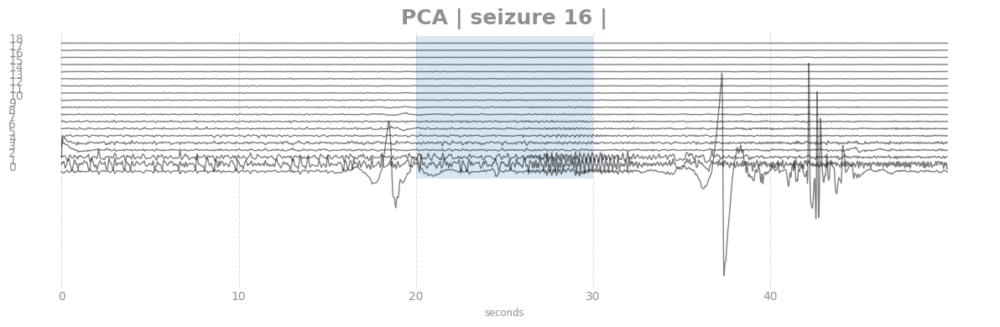

[0.91301057 0.96715555 0.98468026 0.98982889 0.99415629 0.99578276
 0.99713684 0.99808212 0.9986826  0.99906949 0.99933359 0.99951161
 0.99965945 0.99976954 0.99984871 0.99990936 0.99995309 0.99998464
 1.        ]
3030710864


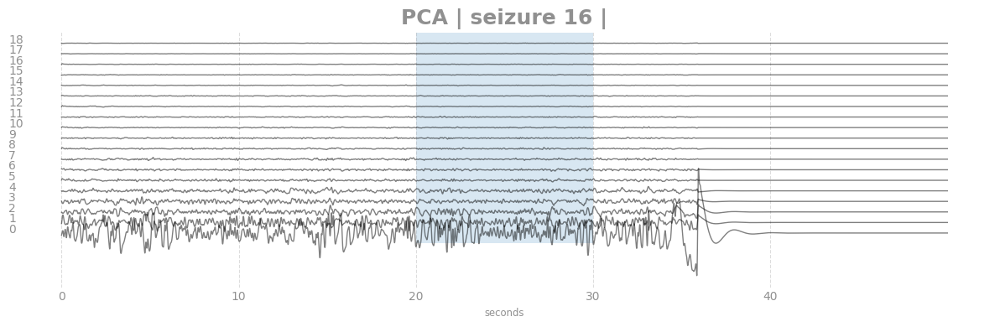

[0.86976878 0.94125989 0.96982487 0.98252558 0.99179156 0.99396572
 0.99571034 0.99712194 0.99785199 0.99841035 0.99880159 0.99914593
 0.99939004 0.99958178 0.99973583 0.99985487 0.99993295 0.99997302
 1.        ]
241433122


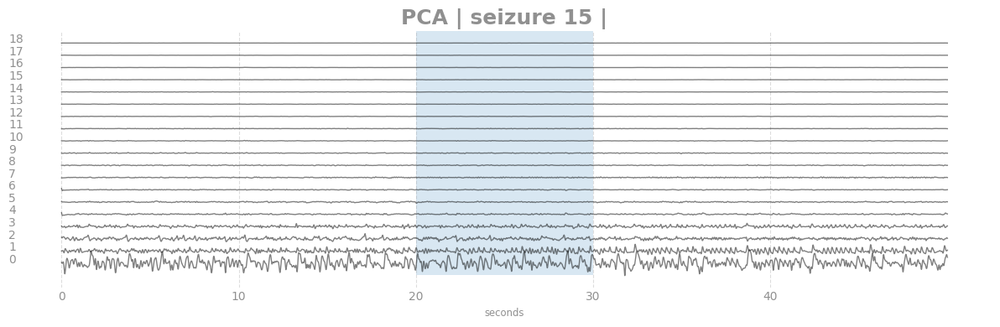

[0.78567003 0.90072462 0.94821142 0.97963022 0.98650263 0.99061812
 0.99320687 0.99556218 0.9970639  0.99814475 0.99869774 0.99905408
 0.99931658 0.99951775 0.99970473 0.99983509 0.99990184 0.99996043
 1.        ]
794842413


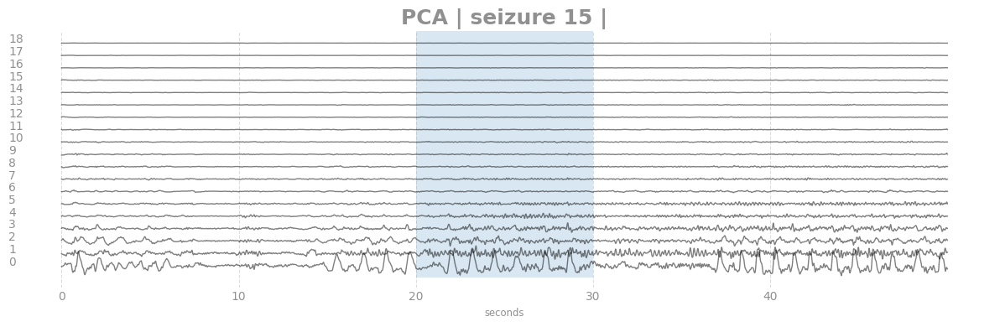

[0.75956365 0.85311418 0.92229885 0.96226846 0.97501901 0.98560105
 0.98946854 0.99262464 0.99497005 0.99636098 0.99762073 0.99820388
 0.99866187 0.99906402 0.99936392 0.99964354 0.99983766 0.99995423
 1.        ]
658623458


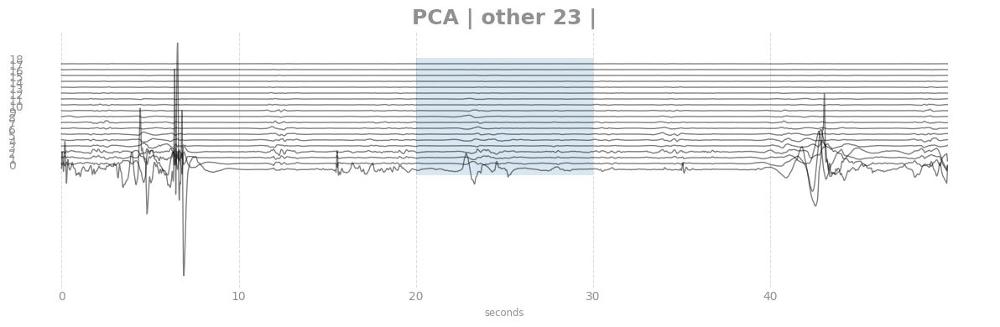

[0.77324431 0.89955461 0.95997748 0.99118342 0.99485897 0.99655605
 0.99750708 0.9981975  0.9987471  0.99915428 0.99947483 0.9996416
 0.99978406 0.99984768 0.99989368 0.99993249 0.99996611 0.99998659
 1.        ]
590374806


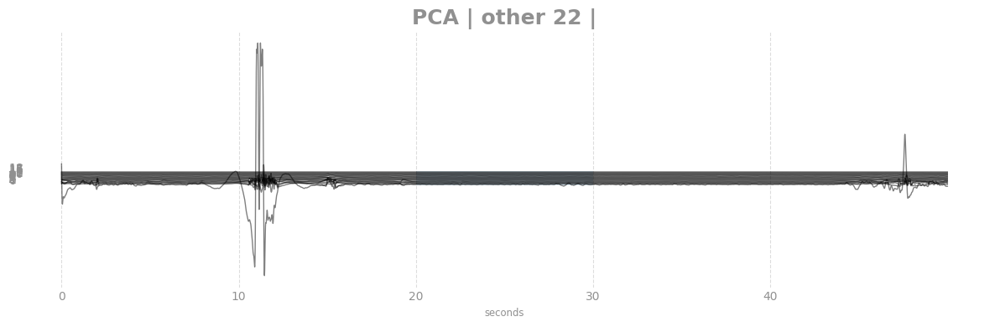

[0.97976617 0.98609532 0.99098569 0.99489042 0.99740128 0.99846073
 0.99903377 0.9995729  0.99977527 0.99987029 0.99990652 0.99994174
 0.99996462 0.99998204 0.99999    0.9999947  0.99999826 0.9999995
 1.        ]
811958440


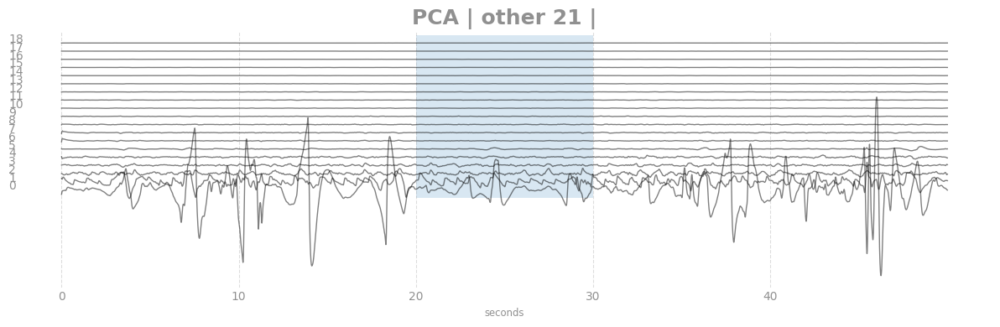

[0.94670717 0.99201932 0.9971385  0.99831146 0.99905285 0.99947382
 0.99965629 0.99981623 0.99988452 0.99992015 0.99994425 0.99996383
 0.99997727 0.99998496 0.99999047 0.99999406 0.99999651 0.99999883
 1.        ]
936283997


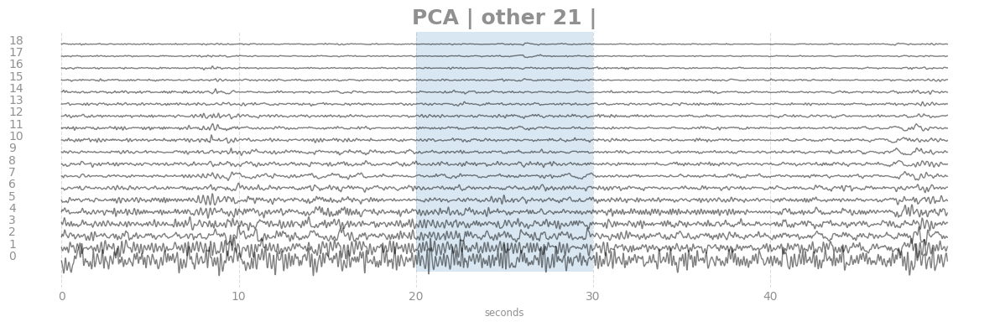

[0.45694314 0.63560058 0.73754935 0.80415245 0.85450829 0.88337944
 0.90511347 0.92403295 0.94085101 0.95379773 0.96409743 0.97311526
 0.98122504 0.98701548 0.99215251 0.99483136 0.99693008 0.99861085
 1.        ]
2713014975


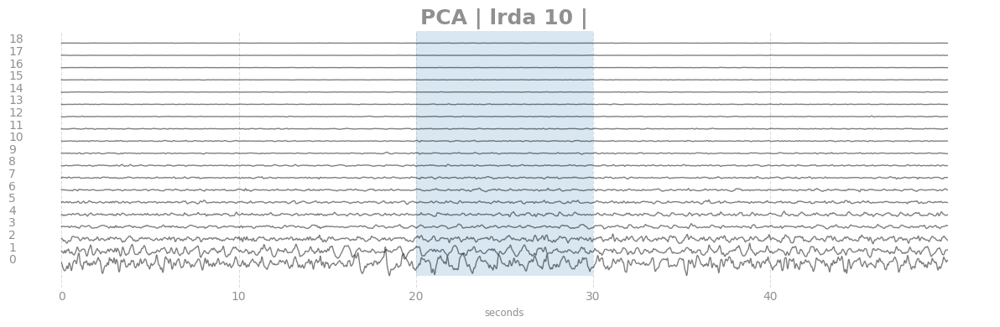

[0.5360523  0.78324645 0.88783428 0.9262592  0.95779233 0.97125382
 0.98145497 0.98735688 0.99143218 0.99386664 0.99596879 0.9973457
 0.99824117 0.99890035 0.99930181 0.99957087 0.99977677 0.99992502
 1.        ]
839459106


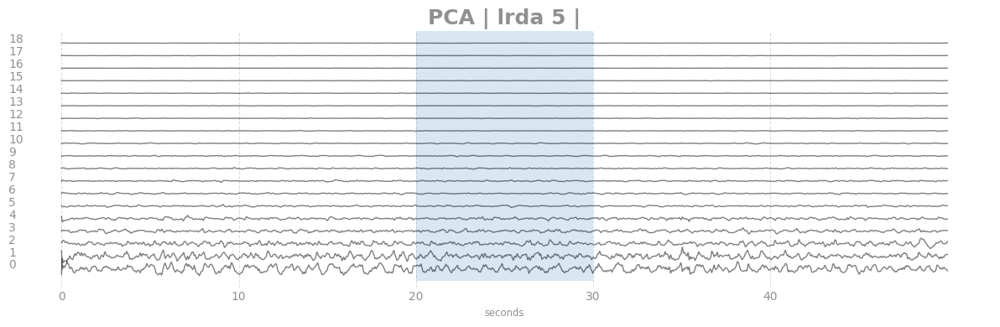

[0.47011207 0.74997285 0.87594508 0.92521246 0.96075823 0.97128245
 0.97981803 0.98707387 0.99125665 0.99429717 0.99651084 0.99747867
 0.9983052  0.99882071 0.99923369 0.99955404 0.99975236 0.99989673
 1.        ]
7585449


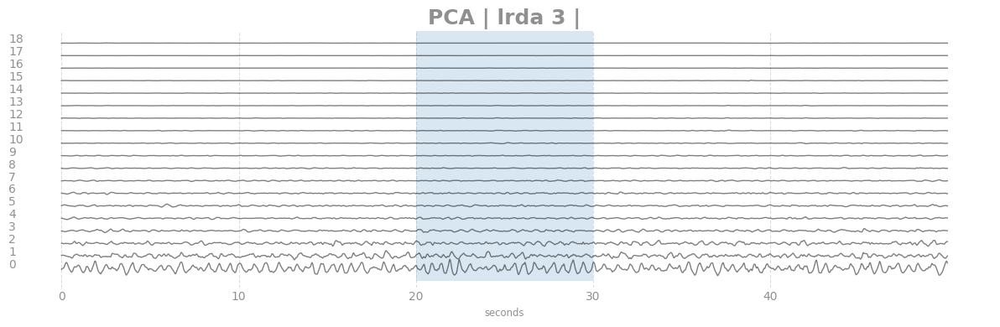

[0.7034802  0.85063815 0.92100641 0.94750145 0.96312761 0.97534747
 0.98453338 0.98969499 0.99285543 0.99520737 0.99667954 0.99796655
 0.99865896 0.99909861 0.99948216 0.99971381 0.9998374  0.99992009
 1.        ]
50469106


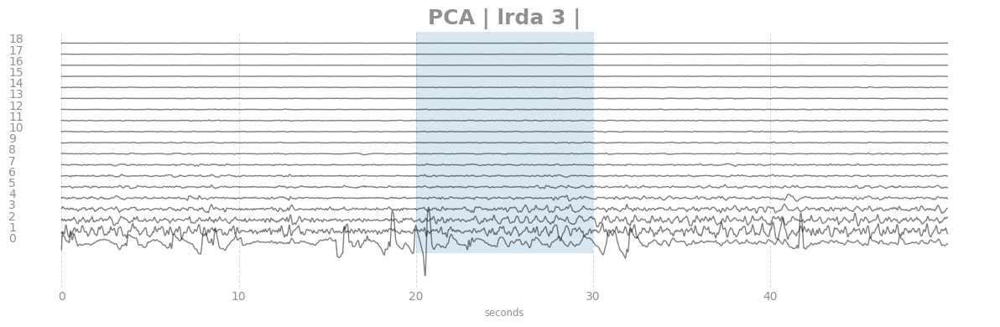

[0.72679392 0.87671446 0.94162057 0.9723902  0.98301618 0.98843737
 0.99219419 0.9944951  0.99587821 0.99700225 0.99782573 0.99850718
 0.99896102 0.99933108 0.99962801 0.9997841  0.99988412 0.99997366
 1.        ]
1317431280


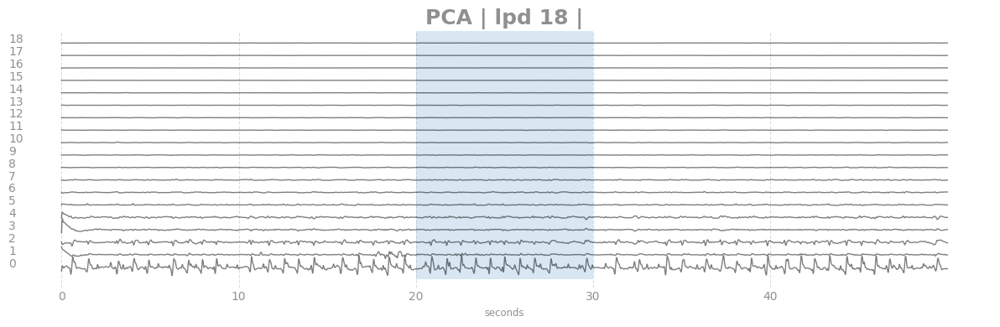

[0.71807238 0.86609192 0.93205756 0.96069204 0.98162907 0.98719069
 0.99161871 0.99523107 0.99662255 0.99774288 0.99853937 0.99896204
 0.99927245 0.99951612 0.99965353 0.9997804  0.99986658 0.99994297
 1.        ]
1898956741


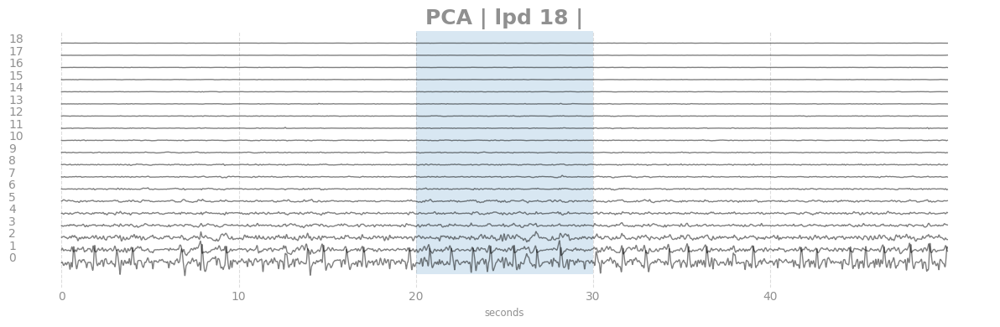

[0.75512577 0.87204338 0.94585651 0.96524506 0.97727354 0.98743422
 0.99072391 0.99331332 0.99514622 0.99657291 0.99755599 0.99827746
 0.99876832 0.9991531  0.99941177 0.99965257 0.99981239 0.99992689
 1.        ]
4221431176


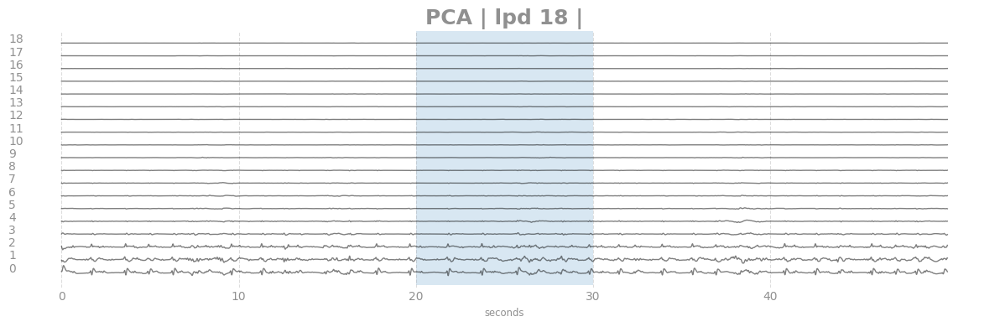

[0.44997214 0.76727468 0.93614602 0.9608565  0.97534399 0.9822215
 0.98727472 0.99055529 0.99290844 0.99474036 0.99591835 0.99689426
 0.99761579 0.9983041  0.99881502 0.99926944 0.99956159 0.99982081
 1.        ]
35755743


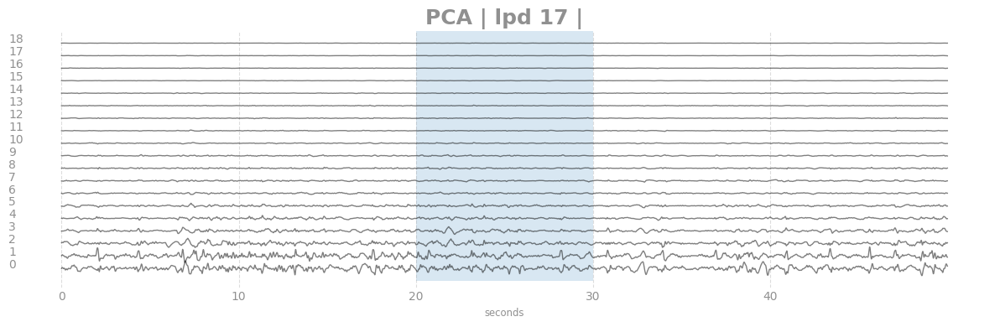

[0.37201546 0.68236514 0.81595429 0.88859932 0.92400016 0.94979893
 0.96137968 0.97280876 0.98016627 0.98666175 0.99054964 0.99284999
 0.99508579 0.99676582 0.99818919 0.9987997  0.99935811 0.99974959
 1.        ]
167136080


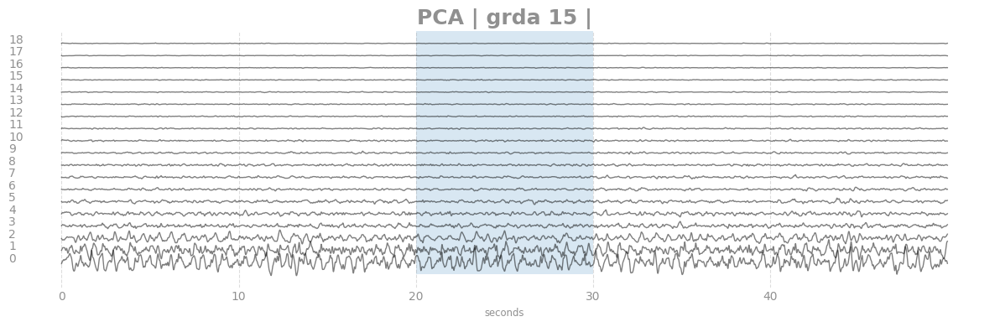

[0.58118354 0.78664385 0.9051751  0.93062664 0.9516871  0.96831649
 0.97574937 0.98213378 0.98751837 0.99115791 0.99377879 0.99545858
 0.99661609 0.99755291 0.99830464 0.9989441  0.9993927  0.9997376
 1.        ]
944845698


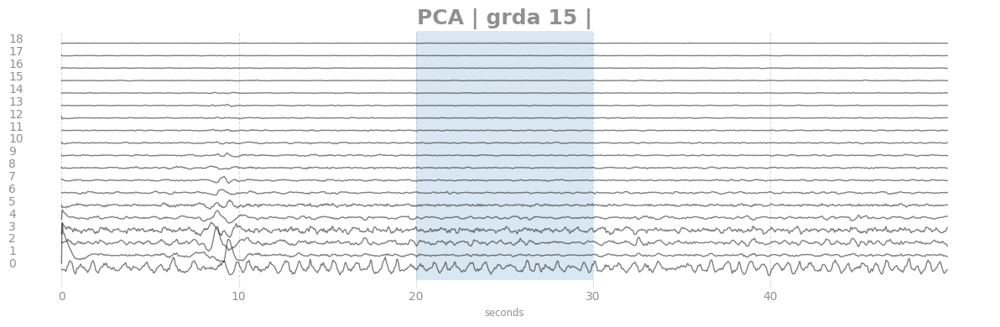

[0.41753226 0.63898723 0.77753323 0.88509257 0.93389171 0.95602077
 0.96890452 0.97748569 0.98311952 0.98835876 0.99232615 0.99441215
 0.99604744 0.99734551 0.99816531 0.99894648 0.99954907 0.99988541
 1.        ]
963265939


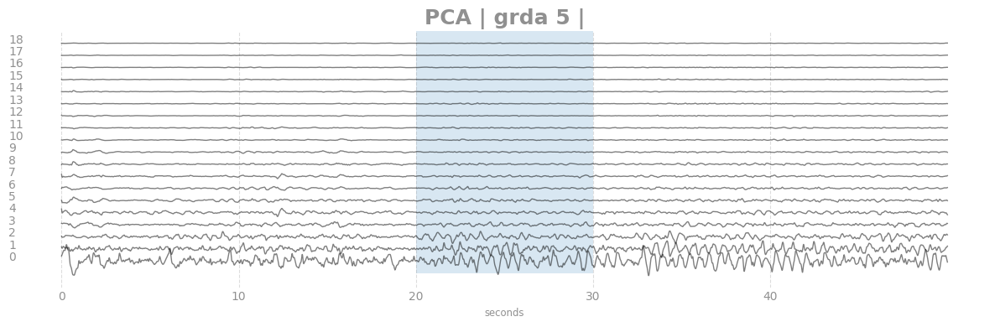

[0.56580284 0.80167647 0.89289986 0.92378798 0.95049862 0.96474435
 0.97454596 0.98176109 0.98765081 0.99172893 0.99372201 0.99540745
 0.9964845  0.99743587 0.99826266 0.99888548 0.99937182 0.99979519
 1.        ]
5168624


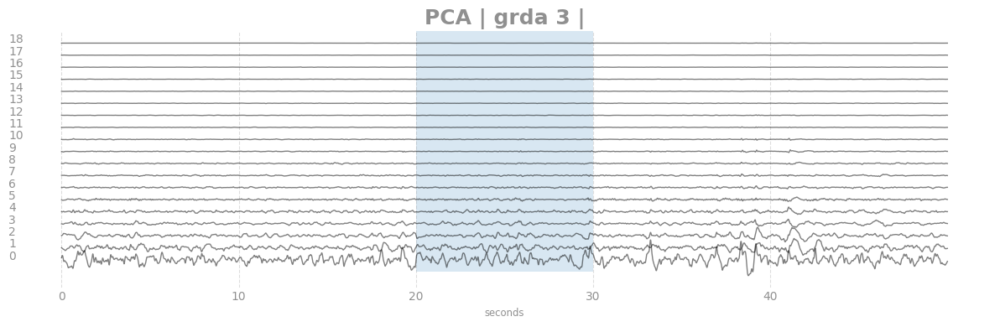

[0.65602382 0.81648383 0.9126491  0.94877206 0.97272194 0.98215381
 0.98817911 0.99238102 0.9954319  0.99697324 0.99812477 0.99862054
 0.99897402 0.99929708 0.99956458 0.99973841 0.9998574  0.99995378
 1.        ]
1058173302


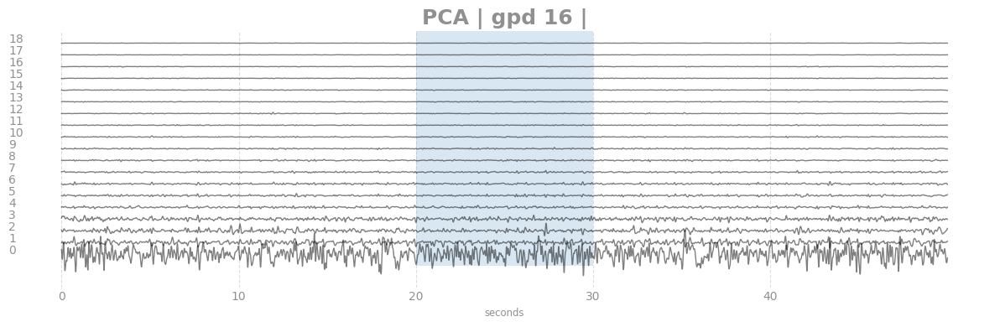

[0.86808325 0.91958141 0.95330142 0.9750707  0.98152568 0.98629528
 0.99030068 0.99301819 0.99501584 0.9964242  0.99731081 0.9980037
 0.9985482  0.99893794 0.99929054 0.99954008 0.99978898 0.99992652
 1.        ]
1300795281


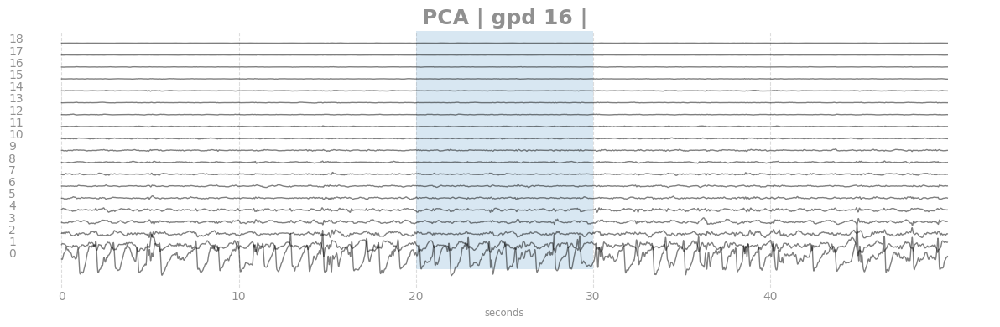

[0.86518914 0.94841655 0.96952637 0.98192406 0.98925782 0.99193813
 0.99404116 0.99553859 0.9969837  0.99828537 0.99874863 0.99906218
 0.99931144 0.99953583 0.99971821 0.99985377 0.99993334 0.99997177
 1.        ]
1463717064


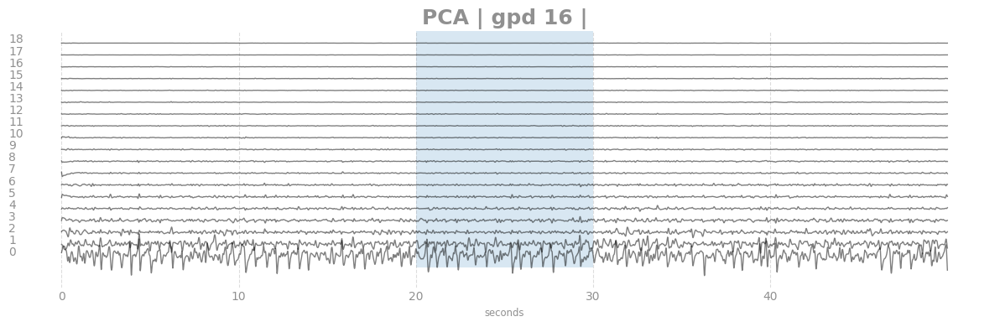

[0.77513282 0.92257999 0.9535731  0.97234151 0.98091278 0.98722172
 0.99138894 0.99404613 0.99604181 0.9969675  0.99780147 0.99842101
 0.99895596 0.99929503 0.99955506 0.99978061 0.99990588 0.99996823
 1.        ]
1606805366


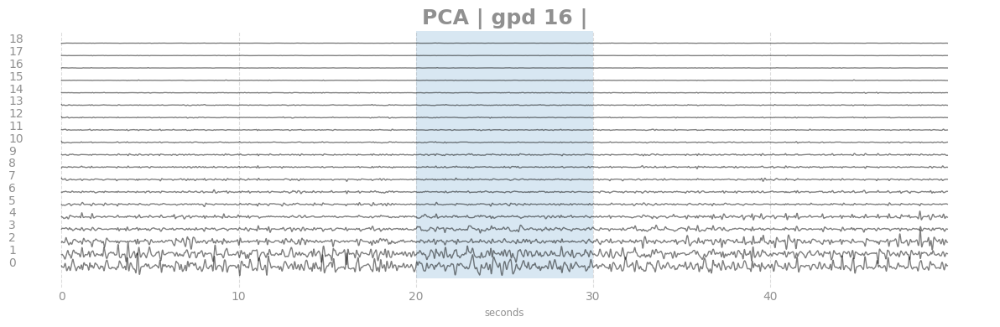

[0.43734474 0.71562612 0.87830564 0.91882952 0.95251589 0.96417827
 0.97309384 0.98086022 0.98625463 0.99082589 0.99329911 0.99531781
 0.99702652 0.99832545 0.99898467 0.99938051 0.99966287 0.99986468
 1.        ]


In [9]:
def filter_eeg(eeg):
    b, a = signal.butter(N=4, Wn=[0.5, 10], btype='band', fs=SR)
    filtered_data = signal.filtfilt(b, a, eeg.values, axis=0)
    return pd.DataFrame(filtered_data, columns=eeg.columns)

path_eeg = 'data/train_eegs/'
path_spectrogram = 'data/train_spectrograms/'
SPECTROGRAMS = ['LL','LP','RP','RL']
SP_LEN = 300
SP_NUM_FREQ = 100
SPECTROGRAM_COLS = [
['LL_0.59', 'LL_0.78', 'LL_0.98', 'LL_1.17', 'LL_1.37', 'LL_1.56', 'LL_1.76', 'LL_1.95', 'LL_2.15', 'LL_2.34', 'LL_2.54', 'LL_2.73', 'LL_2.93', 'LL_3.13', 'LL_3.32', 'LL_3.52', 'LL_3.71', 'LL_3.91', 'LL_4.1', 'LL_4.3', 'LL_4.49', 'LL_4.69', 'LL_4.88', 'LL_5.08', 'LL_5.27', 'LL_5.47', 'LL_5.66', 'LL_5.86', 'LL_6.05', 'LL_6.25', 'LL_6.45', 'LL_6.64', 'LL_6.84', 'LL_7.03', 'LL_7.23', 'LL_7.42', 'LL_7.62', 'LL_7.81', 'LL_8.01', 'LL_8.2', 'LL_8.4', 'LL_8.59', 'LL_8.79', 'LL_8.98', 'LL_9.18', 'LL_9.38', 'LL_9.57', 'LL_9.77', 'LL_9.96', 'LL_10.16', 'LL_10.35', 'LL_10.55', 'LL_10.74', 'LL_10.94', 'LL_11.13', 'LL_11.33', 'LL_11.52', 'LL_11.72', 'LL_11.91', 'LL_12.11', 'LL_12.3', 'LL_12.5', 'LL_12.7', 'LL_12.89', 'LL_13.09', 'LL_13.28', 'LL_13.48', 'LL_13.67', 'LL_13.87', 'LL_14.06', 'LL_14.26', 'LL_14.45', 'LL_14.65', 'LL_14.84', 'LL_15.04', 'LL_15.23', 'LL_15.43', 'LL_15.63', 'LL_15.82', 'LL_16.02', 'LL_16.21', 'LL_16.41', 'LL_16.6', 'LL_16.8', 'LL_16.99', 'LL_17.19', 'LL_17.38', 'LL_17.58', 'LL_17.77', 'LL_17.97', 'LL_18.16', 'LL_18.36', 'LL_18.55', 'LL_18.75', 'LL_18.95', 'LL_19.14', 'LL_19.34', 'LL_19.53', 'LL_19.73', 'LL_19.92'],
['LP_0.59', 'LP_0.78', 'LP_0.98', 'LP_1.17', 'LP_1.37', 'LP_1.56', 'LP_1.76', 'LP_1.95', 'LP_2.15', 'LP_2.34', 'LP_2.54', 'LP_2.73', 'LP_2.93', 'LP_3.13', 'LP_3.32', 'LP_3.52', 'LP_3.71', 'LP_3.91', 'LP_4.1', 'LP_4.3', 'LP_4.49', 'LP_4.69', 'LP_4.88', 'LP_5.08', 'LP_5.27', 'LP_5.47', 'LP_5.66', 'LP_5.86', 'LP_6.05', 'LP_6.25', 'LP_6.45', 'LP_6.64', 'LP_6.84', 'LP_7.03', 'LP_7.23', 'LP_7.42', 'LP_7.62', 'LP_7.81', 'LP_8.01', 'LP_8.2', 'LP_8.4', 'LP_8.59', 'LP_8.79', 'LP_8.98', 'LP_9.18', 'LP_9.38', 'LP_9.57', 'LP_9.77', 'LP_9.96', 'LP_10.16', 'LP_10.35', 'LP_10.55', 'LP_10.74', 'LP_10.94', 'LP_11.13', 'LP_11.33', 'LP_11.52', 'LP_11.72', 'LP_11.91', 'LP_12.11', 'LP_12.3', 'LP_12.5', 'LP_12.7', 'LP_12.89', 'LP_13.09', 'LP_13.28', 'LP_13.48', 'LP_13.67', 'LP_13.87', 'LP_14.06', 'LP_14.26', 'LP_14.45', 'LP_14.65', 'LP_14.84', 'LP_15.04', 'LP_15.23', 'LP_15.43', 'LP_15.63', 'LP_15.82', 'LP_16.02', 'LP_16.21', 'LP_16.41', 'LP_16.6', 'LP_16.8', 'LP_16.99', 'LP_17.19', 'LP_17.38', 'LP_17.58', 'LP_17.77', 'LP_17.97', 'LP_18.16', 'LP_18.36', 'LP_18.55', 'LP_18.75', 'LP_18.95', 'LP_19.14', 'LP_19.34', 'LP_19.53', 'LP_19.73', 'LP_19.92'],
['RP_0.59', 'RP_0.78', 'RP_0.98', 'RP_1.17', 'RP_1.37', 'RP_1.56', 'RP_1.76', 'RP_1.95', 'RP_2.15', 'RP_2.34', 'RP_2.54', 'RP_2.73', 'RP_2.93', 'RP_3.13', 'RP_3.32', 'RP_3.52', 'RP_3.71', 'RP_3.91', 'RP_4.1', 'RP_4.3', 'RP_4.49', 'RP_4.69', 'RP_4.88', 'RP_5.08', 'RP_5.27', 'RP_5.47', 'RP_5.66', 'RP_5.86', 'RP_6.05', 'RP_6.25', 'RP_6.45', 'RP_6.64', 'RP_6.84', 'RP_7.03', 'RP_7.23', 'RP_7.42', 'RP_7.62', 'RP_7.81', 'RP_8.01', 'RP_8.2', 'RP_8.4', 'RP_8.59', 'RP_8.79', 'RP_8.98', 'RP_9.18', 'RP_9.38', 'RP_9.57', 'RP_9.77', 'RP_9.96', 'RP_10.16', 'RP_10.35', 'RP_10.55', 'RP_10.74', 'RP_10.94', 'RP_11.13', 'RP_11.33', 'RP_11.52', 'RP_11.72', 'RP_11.91', 'RP_12.11', 'RP_12.3', 'RP_12.5', 'RP_12.7', 'RP_12.89', 'RP_13.09', 'RP_13.28', 'RP_13.48', 'RP_13.67', 'RP_13.87', 'RP_14.06', 'RP_14.26', 'RP_14.45', 'RP_14.65', 'RP_14.84', 'RP_15.04', 'RP_15.23', 'RP_15.43', 'RP_15.63', 'RP_15.82', 'RP_16.02', 'RP_16.21', 'RP_16.41', 'RP_16.6', 'RP_16.8', 'RP_16.99', 'RP_17.19', 'RP_17.38', 'RP_17.58', 'RP_17.77', 'RP_17.97', 'RP_18.16', 'RP_18.36', 'RP_18.55', 'RP_18.75', 'RP_18.95', 'RP_19.14', 'RP_19.34', 'RP_19.53', 'RP_19.73', 'RP_19.92'],
['RL_0.59', 'RL_0.78', 'RL_0.98', 'RL_1.17', 'RL_1.37', 'RL_1.56', 'RL_1.76', 'RL_1.95', 'RL_2.15', 'RL_2.34', 'RL_2.54', 'RL_2.73', 'RL_2.93', 'RL_3.13', 'RL_3.32', 'RL_3.52', 'RL_3.71', 'RL_3.91', 'RL_4.1', 'RL_4.3', 'RL_4.49', 'RL_4.69', 'RL_4.88', 'RL_5.08', 'RL_5.27', 'RL_5.47', 'RL_5.66', 'RL_5.86', 'RL_6.05', 'RL_6.25', 'RL_6.45', 'RL_6.64', 'RL_6.84', 'RL_7.03', 'RL_7.23', 'RL_7.42', 'RL_7.62', 'RL_7.81', 'RL_8.01', 'RL_8.2', 'RL_8.4', 'RL_8.59', 'RL_8.79', 'RL_8.98', 'RL_9.18', 'RL_9.38', 'RL_9.57', 'RL_9.77', 'RL_9.96', 'RL_10.16', 'RL_10.35', 'RL_10.55', 'RL_10.74', 'RL_10.94', 'RL_11.13', 'RL_11.33', 'RL_11.52', 'RL_11.72', 'RL_11.91', 'RL_12.11', 'RL_12.3', 'RL_12.5', 'RL_12.7', 'RL_12.89', 'RL_13.09', 'RL_13.28', 'RL_13.48', 'RL_13.67', 'RL_13.87', 'RL_14.06', 'RL_14.26', 'RL_14.45', 'RL_14.65', 'RL_14.84', 'RL_15.04', 'RL_15.23', 'RL_15.43', 'RL_15.63', 'RL_15.82', 'RL_16.02', 'RL_16.21', 'RL_16.41', 'RL_16.6', 'RL_16.8', 'RL_16.99', 'RL_17.19', 'RL_17.38', 'RL_17.58', 'RL_17.77', 'RL_17.97', 'RL_18.16', 'RL_18.36', 'RL_18.55', 'RL_18.75', 'RL_18.95', 'RL_19.14', 'RL_19.34', 'RL_19.53', 'RL_19.73', 'RL_19.92'],
]
eps = 1e-10

for index, row in df_ideal.iterrows():
    print(row['eeg_id'])
    
    label = get_diagnosis(row.iloc[-6:].to_dict())
    eeg = pd.read_parquet(path_eeg + f'{row["eeg_id"]}.parquet').drop('EKG', axis=1).fillna(0)

    eeg_filt = filter_eeg(eeg)

    pca = PCA(n_components=19, random_state=42)
    pca_res = pca.fit_transform(eeg_filt.values)
    display_eegs(pd.DataFrame(pca_res / 32.), 'PCA ' + label)
    print(pca.explained_variance_ratio_.cumsum())